# Camera Calibration
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [1]:
# Global Variables for running noteobok with outputs to help tuning

PERFORMONPICTURES = 1

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import matplotlib.image as mping

#Calibrating Camera Lecture

cal_images = glob.glob('camera_cal/*.jpg')

objpoints = []
imgpoints = []

# prepare object points
objp = np.zeros((9*6,3),np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

for fname in cal_images:
        # Read Image
        image = mping.imread(fname)
        # Convert to gray scale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        # Find Chess Board Corners
        ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)
        # If Corners are found, add object points, and image points
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
            if(PERFORMONPICTURES):
                img = cv2.drawChessboardCorners(image, (9,6), corners, ret)
                plt.imshow(img)
                plt.show()
        elif(PERFORMONPICTURES):
            print("Corners not found")
            plt.imshow(image)
            plt.show()
        
def undistortImage(img, objpoints, imgpoints):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist=cv2.undistort(img, mtx, dist, None, mtx)
    return undist

if(PERFORMONPICTURES):
    for fname in cal_images:
        image = cv2.imread(fname)
        undist = undistortImage(image, objpoints, imgpoints)
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(undist)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


Corners not found


Corners not found


Corners not found


* Apply a distortion correction to raw images.


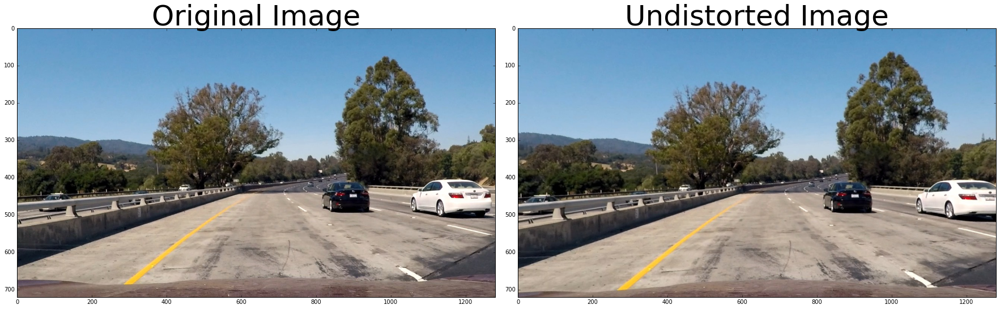

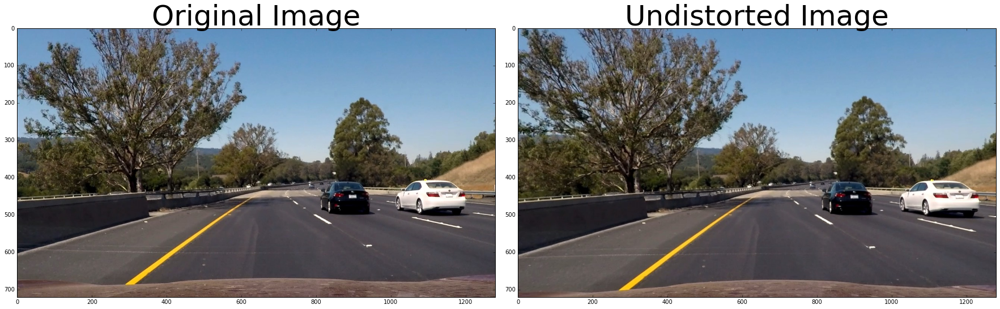

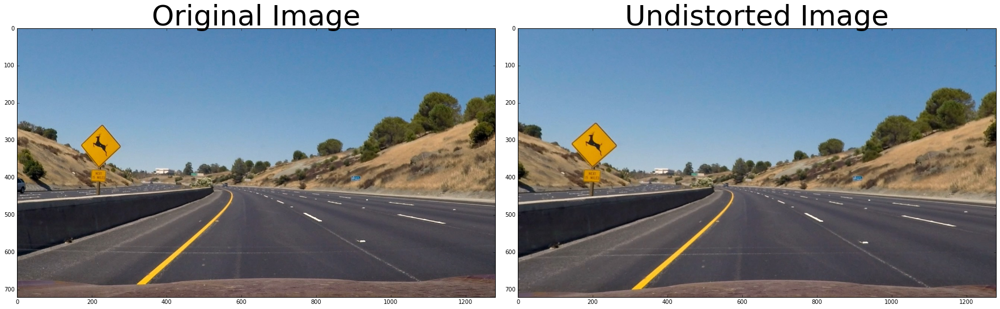

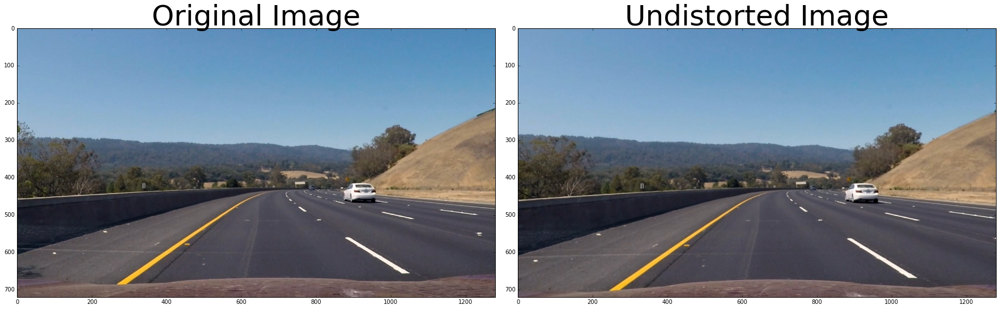

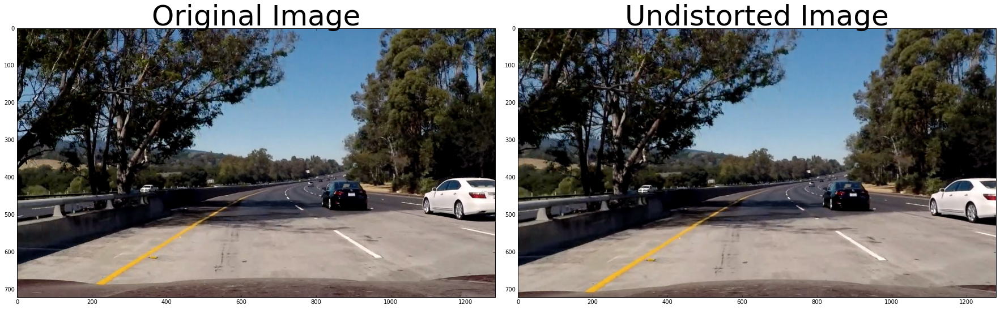

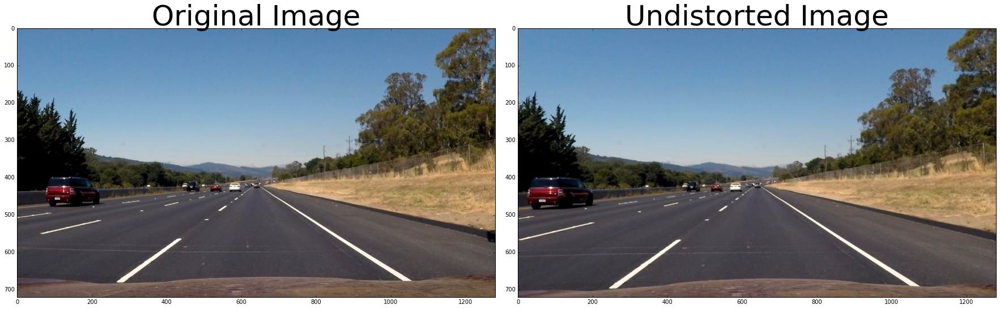

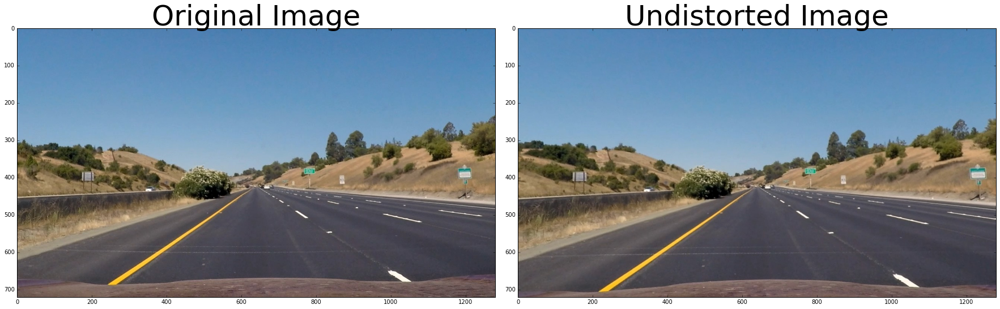

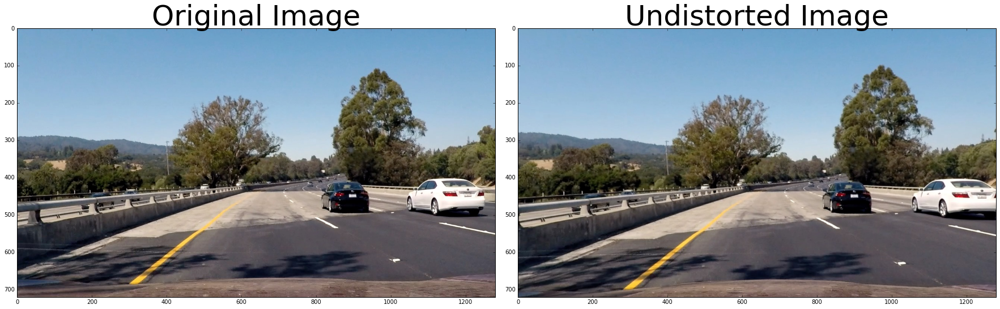

In [3]:
test_images = glob.glob('test_images/*.jpg')

for fname in test_images:
    image = mping.imread(fname)
    undist = undistortImage(image, objpoints, imgpoints)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()



# Color transormations, gradients, and thresholding
* Use color transforms, gradients, etc., to create a thresholded binary image.


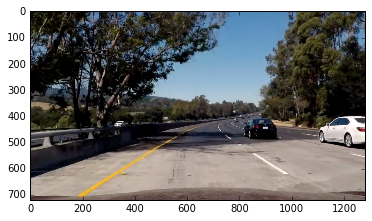

R_Channel


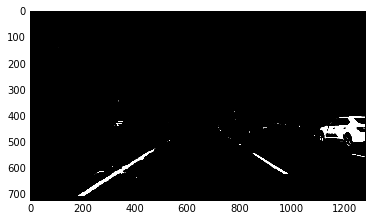

s_channel


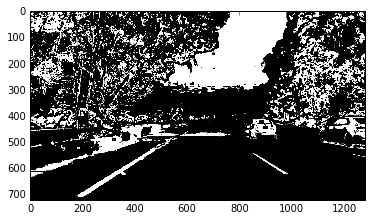

S and R


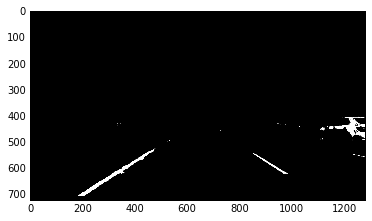

gradx


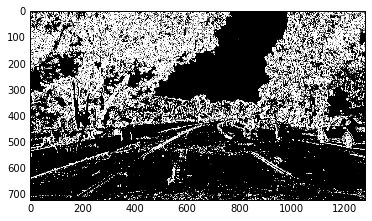

Gradx on s channel


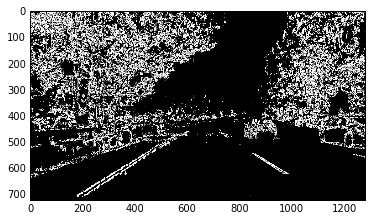

Gradx on R channel


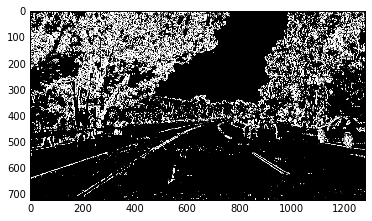

grady


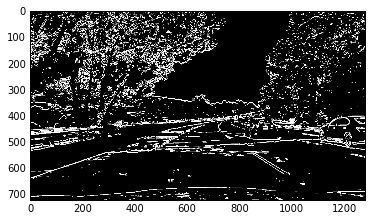

mag_binary


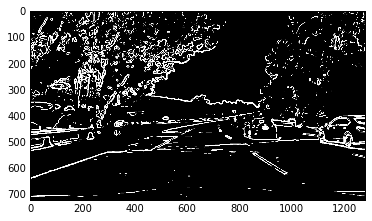

s_channel mag_binary


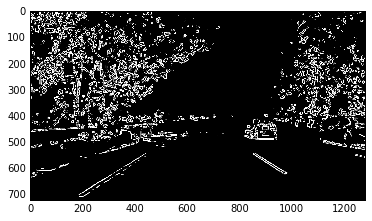

Red mag_binary


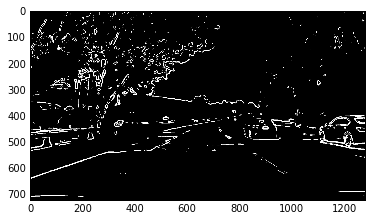

dir_binary


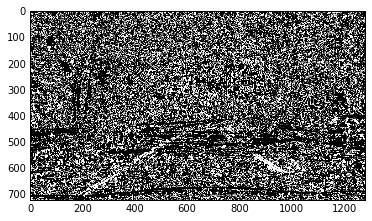

combined


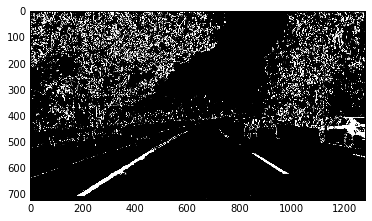

Color Binary


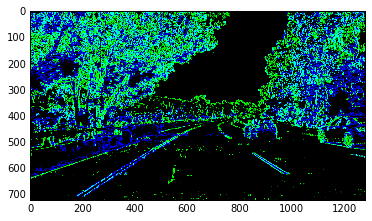

In [5]:
# Combining Thresholds Lecture
# Exploring different methods with single picture

def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_threshold(gray, sobel_kernel=3, thresh=(0, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def Threshold(img, thresh=(0, 255)):
    # 2) Apply a threshold
    result = np.zeros_like(img)
    result[(img > thresh[0]) & (img <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return result

if(PERFORMONPICTURES):
    # Choose a Sobel kernel size
    ksize = 13  # Choose a larger odd number to smooth gradient measurements

    image = mping.imread(test_images[4])
    undist = undistortImage(image, objpoints, imgpoints)
    image = undist
    plt.imshow(image)
    plt.show()
    
    R = image[:,:,0]

    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)

    s_channel = hls[:,:,2]
    
    print("R_Channel")
    plt.imshow(Threshold(R,(205,255)), cmap = 'gray')
    plt.show()

    print("s_channel")
    plt.imshow(Threshold(s_channel,(95,255)), cmap = 'gray')
    plt.show()
    
    combined = np.zeros_like(Threshold(s_channel))
    combined[(Threshold(s_channel,(95,255)) == 1) & (Threshold(R,(205,255)) == 1)] = 1
    
    print("S and R")
    plt.imshow(combined, cmap = 'gray')
    plt.show()

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(5, 100))
    print("gradx")
    plt.imshow(gradx, cmap='gray')
    plt.show()

    gradxs = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh = (15,120))
    print("Gradx on s channel")
    plt.imshow(gradxs, cmap='gray')
    plt.show()

    gradxr = abs_sobel_thresh(R, orient='x', sobel_kernel=ksize, thresh = (10,120))
    print("Gradx on R channel")
    plt.imshow(gradxr, cmap='gray')
    plt.show()
    
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(20, 150))
    print("grady")
    plt.imshow(grady, cmap='gray')
    plt.show()

    mag_binary = mag_threshold(gray, sobel_kernel=ksize, thresh=(45, 175))
    print("mag_binary")
    plt.imshow(mag_binary, cmap='gray')
    plt.show()

    mag_binary_s = mag_threshold(s_channel, sobel_kernel=ksize, thresh=(85, 175))
    print("s_channel mag_binary")
    plt.imshow(mag_binary_s, cmap='gray')
    plt.show()
    
    mag_binary_r = mag_threshold(R, sobel_kernel=ksize, thresh=(65, 175))
    print("Red mag_binary")
    plt.imshow(mag_binary_r, cmap='gray')
    plt.show()
    

    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(.7, 1.25)) 
    print("dir_binary")
    plt.imshow(dir_binary, cmap='gray')
    plt.show()

    combined = np.zeros_like(dir_binary)
    #combined[(gradxr == 1) & (gradxs == 1)] = 1
    combined[((Threshold(s_channel,(95,255)) == 1) & (Threshold(R,(205,255)) == 1)) | ((gradxr == 1) & (gradxs == 1))] = 1
    #combined[((mag_binary == 1) & (dir_binary == 1)) | (gradx == 1) | (Threshold(s_channel,(120,255)) == 1)] = 1

    color_binary = np.zeros_like(gradx)
    color_binary = np.dstack(( np.zeros_like(gradx), gradxr, gradxs)) * 255

    print("combined")
    plt.imshow(combined, cmap = 'gray')
    plt.show()
    print("Color Binary")
    plt.imshow(color_binary)
    plt.show()


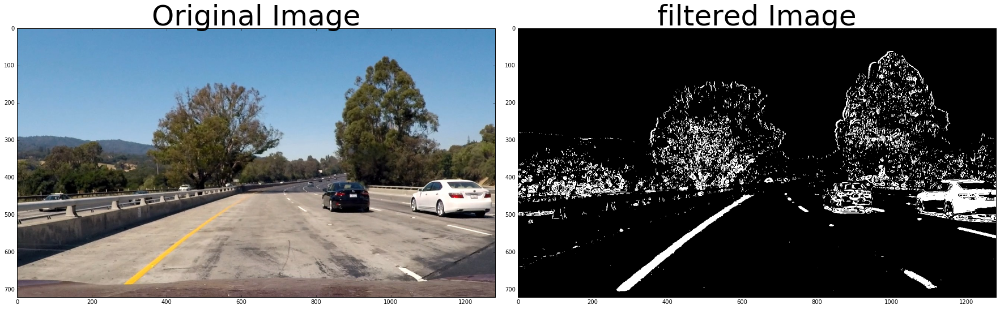

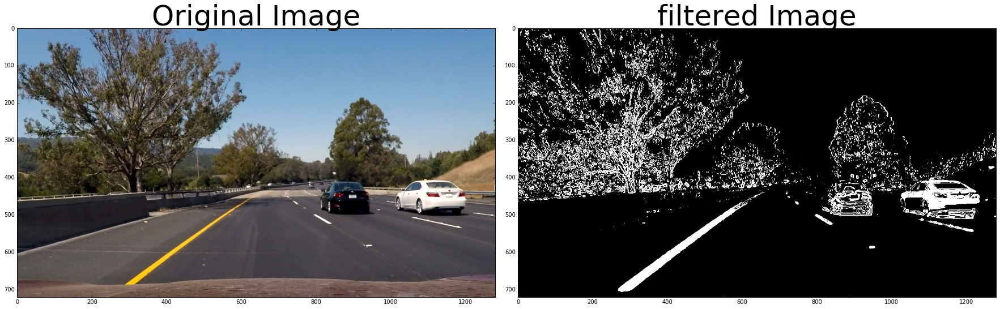

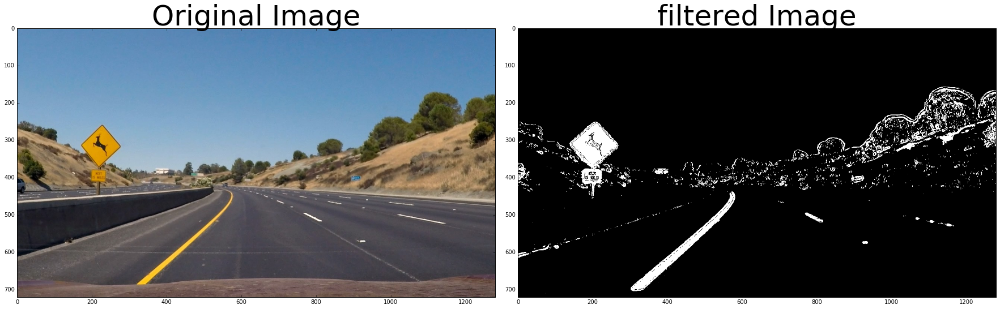

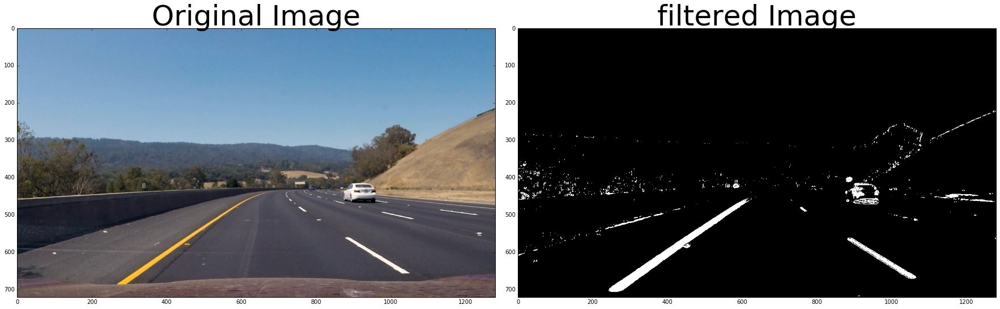

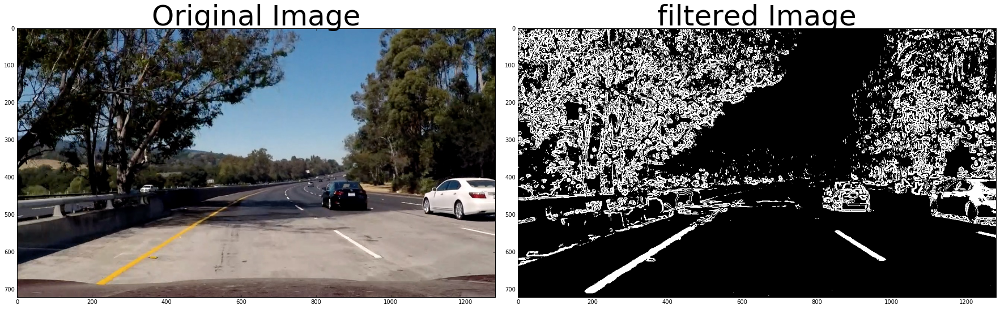

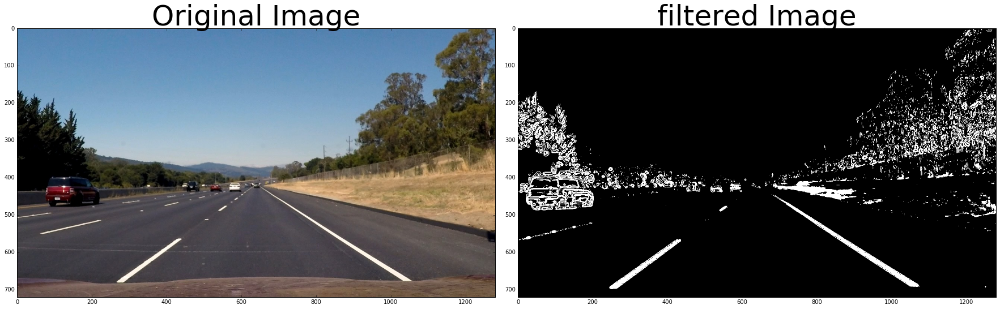

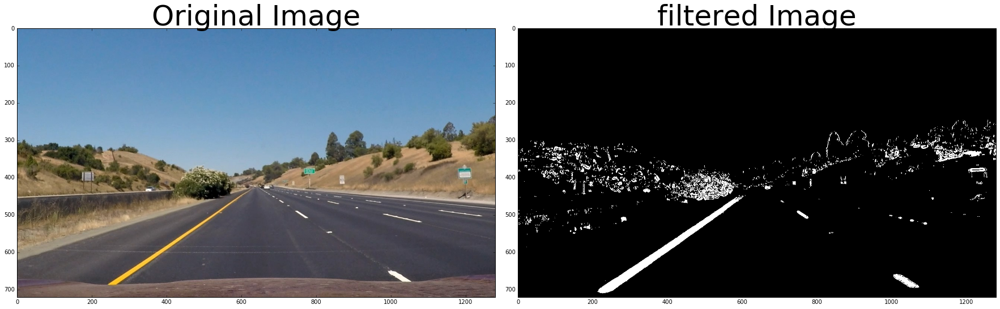

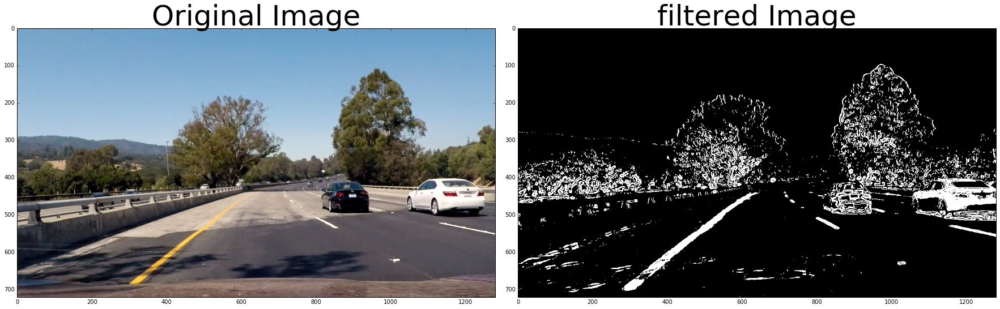

In [6]:
def LightFilter(img, ksize=13, sx_thresh=(20, 100), mag_thresh = (45, 175), dir_thresh = (0.7, 1.25)):
    img = np.copy(img)
    # Convert to Gray
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    # Sobel x on s
    sobelx_s = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh=sx_thresh)
    
    # Magnitude and direction on gray
    mag_binary_gray = mag_threshold(gray, sobel_kernel=ksize, thresh=mag_thresh)
    dir_binary_gray = dir_threshold(gray, sobel_kernel=ksize, thresh=dir_thresh) 
    
    # Combine
    binary = np.zeros_like(sobelx_s)
    binary[((mag_binary_gray == 1) & (dir_binary_gray == 1)) | (sobelx_s == 1)] = 1
    
    return binary

def HeavyFilter(img, ksize = 13, mag_thresh = (45, 175), dir_thresh = (0.7, 1.25)):
    img = np.copy(img)
    #Get red channel
    r_channel = img[:,:,0]
    
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    R = Threshold(r_channel,(205,255))

    S = Threshold(s_channel,(95,255))
    
    gradxs = abs_sobel_thresh(s_channel, orient='x', sobel_kernel=ksize, thresh = (15,120))
    
    gradxr = abs_sobel_thresh(r_channel, orient='x', sobel_kernel=ksize, thresh = (10,120))
        
    mag_binary_s = mag_threshold(s_channel, sobel_kernel=ksize, thresh=(65, 175))
    
    combined = np.zeros_like(R)
    combined[((S == 1) & (R == 1)) | (mag_binary_s == 1) | ((gradxs == 1) & (gradxr == 1))] = 1
    
    return combined
        
def Pipeline(image):
    undist = undistortImage(image, objpoints, imgpoints)
    return HeavyFilter(undist)

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(Pipeline(image), cmap = 'gray')
        ax2.set_title('filtered Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


* Apply a perspective transform to rectify binary image ("birds-eye view").

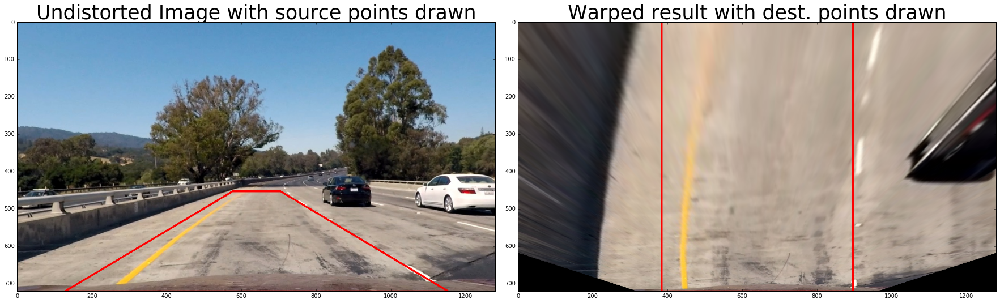

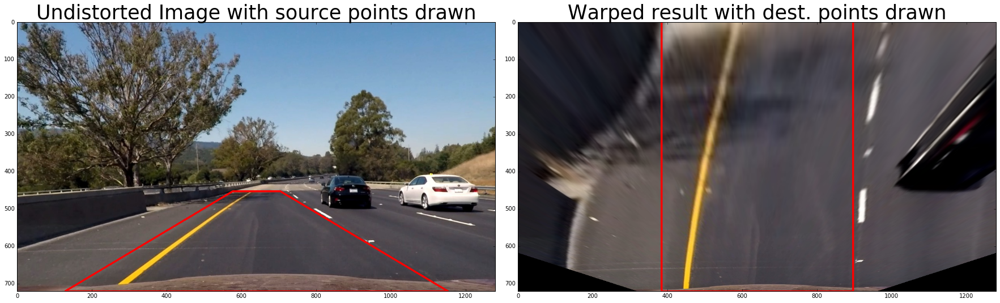

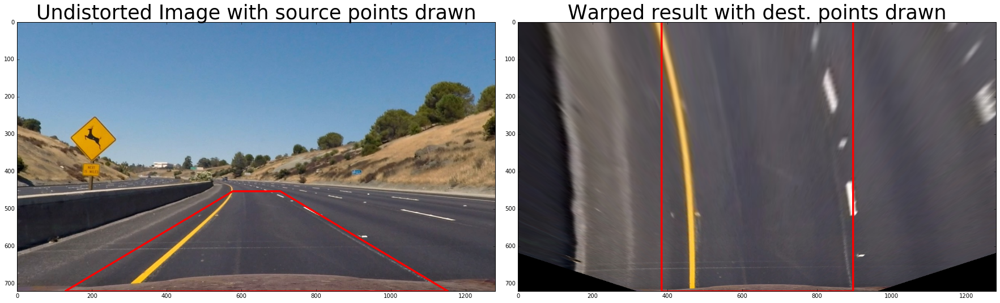

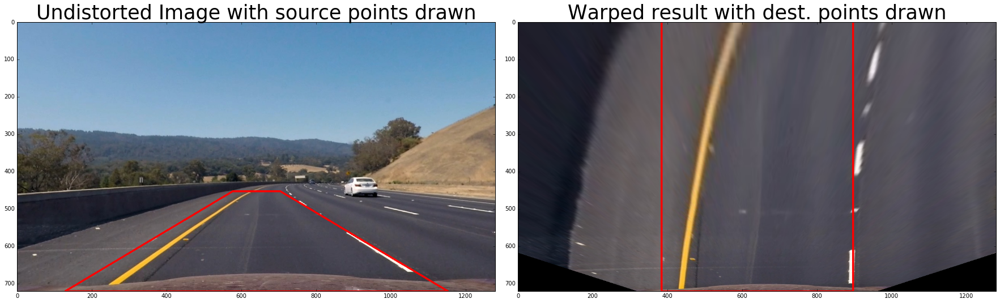

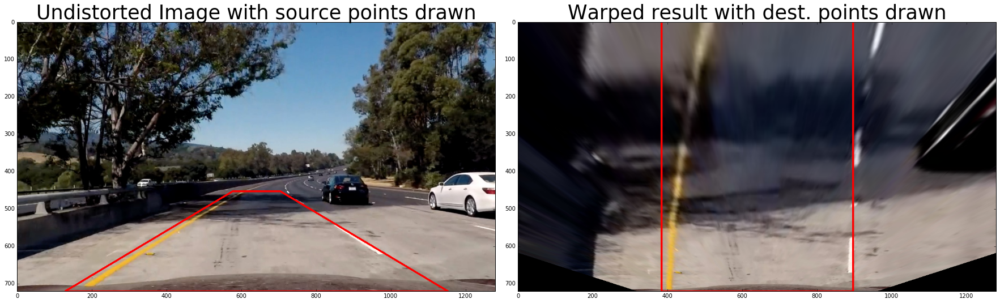

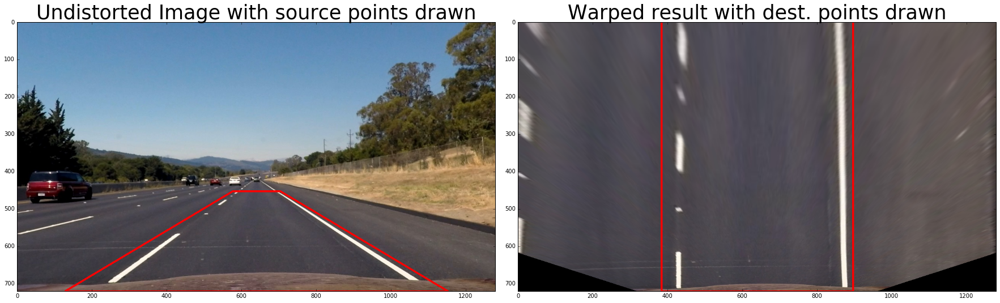

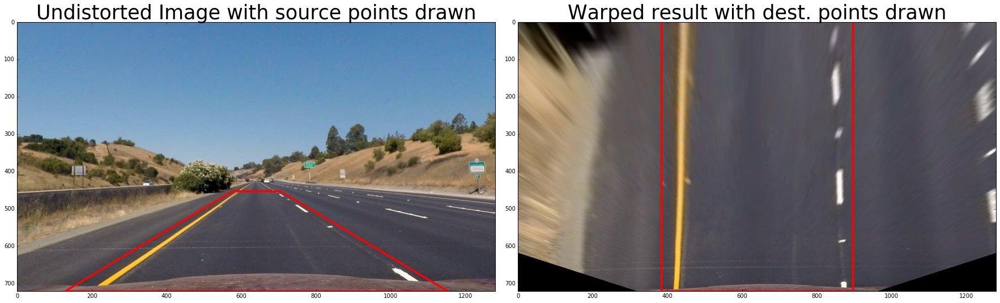

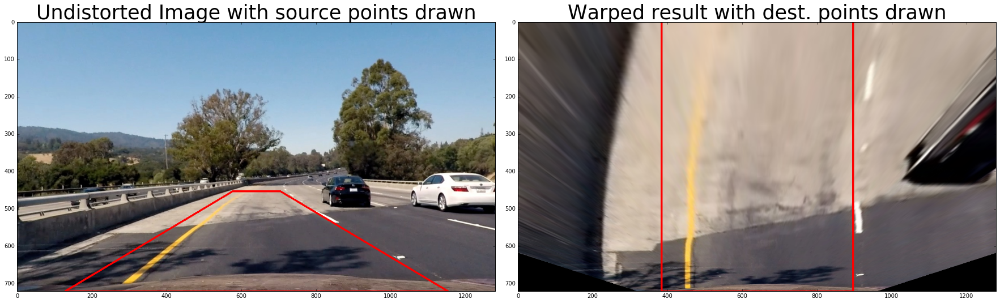

In [7]:
def Warp_Test(image):
    img_size = (image.shape[1], image.shape[0])
    # Move points around more to get better transformation
    src = np.float32(
        [[img_size[0] * 0.45, img_size[1] * 0.63],
        [ img_size[0] * .1, img_size[1]],
        [ img_size[0] * .9, img_size[1]],
        [ img_size[0] * 0.55, img_size[1] * 0.63]])

    dst = np.float32(
        [[img_size[0] * 0.3, 0],
        [img_size[0] * 0.3, img_size[1]],
        [img_size[0] * 0.7, img_size[1]],
        [img_size[0] * 0.7, 0]])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(image, M, img_size)
    return(src, dst, warped, Minv)

def Warp(image):
    src, dest, warped, Minv = Warp_Test(image)
    return (warped, Minv)

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)
        image = undistortImage(image, objpoints, imgpoints)
        
        img_size = (image.shape[1], image.shape[0])

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        src, dst, warp_image, Minv = Warp_Test(image)
        
        #Draw lines on output image
        cv2.line(warp_image, (dst[0][0],dst[0][1]), (dst[1][0],dst[1][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[1][0],dst[1][1]), (dst[2][0],dst[2][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[2][0],dst[2][1]), (dst[3][0],dst[3][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(warp_image, (dst[3][0],dst[3][1]), (dst[0][0],dst[0][1]), (255, 0, 0), thickness=3, lineType=8) 
        
        ax2.imshow(warp_image, cmap = 'gray')
        ax2.set_title('Warped result with dest. points drawn', fontsize=35)

        cv2.line(image, (src[0][0],src[0][1]), (src[1][0],src[1][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[1][0],src[1][1]), (src[2][0],src[2][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[2][0],src[2][1]), (src[3][0],src[3][1]), (255, 0, 0), thickness=3, lineType=8) 
        cv2.line(image, (src[3][0],src[3][1]), (src[0][0],src[0][1]), (255, 0, 0), thickness=3, lineType=8) 

        ax1.imshow(image)
        ax1.set_title('Undistorted Image with source points drawn', fontsize=35)

        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def find_lane_pixels_verbose(binary_warped, ax):  
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]*0.65):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    print(histogram.shape)
    print(leftx_base)
    print(rightx_base)
    
    # Choose the number of sliding windows
    nwindows = 16
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 75
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    ax.imshow(out_img)
    ax.plot(left_fitx, ploty, color='yellow', linewidth = 3)
    ax.plot(right_fitx, ploty, color='yellow', linewidth = 3)

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        test, Minv = Warp(Pipeline(image))
        find_lane_pixels_verbose(test,ax2)
        ax2.set_title('Finding Polynomial Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()

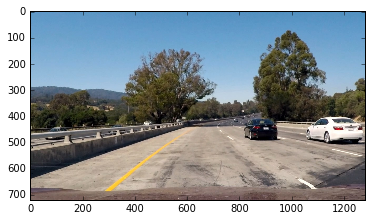

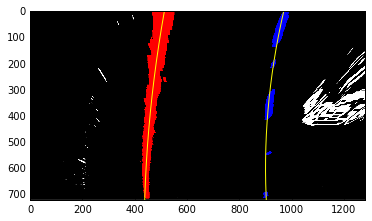

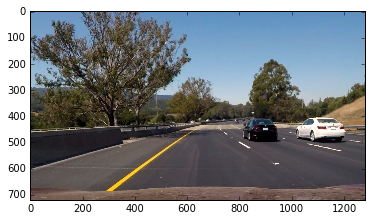

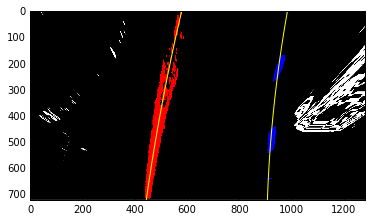

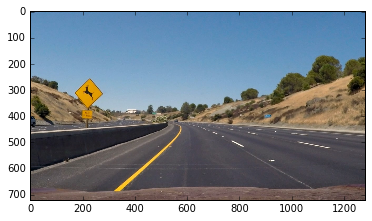

...

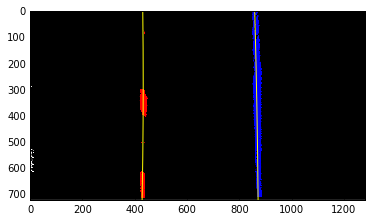

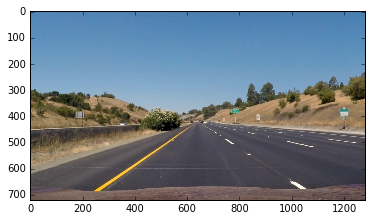

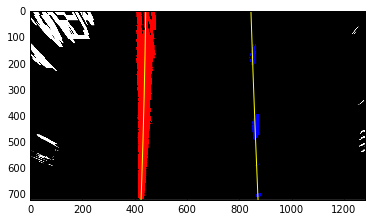

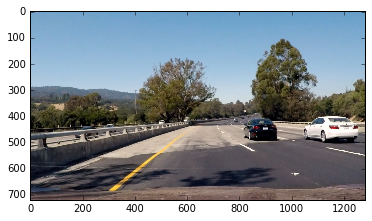

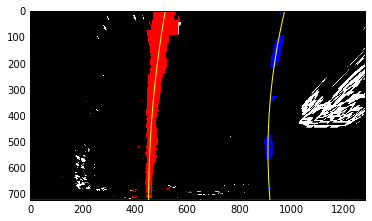

In [9]:

def find_lane_pixels(binary_warped):  
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]*0.65):,:], axis=0)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    #leftx_base = int(midpoint/2 +125)
    #rightx_base = int(midpoint + midpoint/2 -75)
    
    # Choose the number of sliding windows
    nwindows = 16
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 75
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    return (leftx, lefty, rightx, righty)
        
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty
if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)
        plt.imshow(image)
        plt.show()
        test, Minv = Warp(Pipeline(image))
        leftx, lefty, rightx, righty = find_lane_pixels(test)
        out_img = np.dstack((test, test, test))*255
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]
        plt.imshow(out_img)

        left_fitx, right_fitx, ploty = fit_poly((test.shape[1], test.shape[0]), leftx, lefty, rightx, righty)
        
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        
        plt.show()

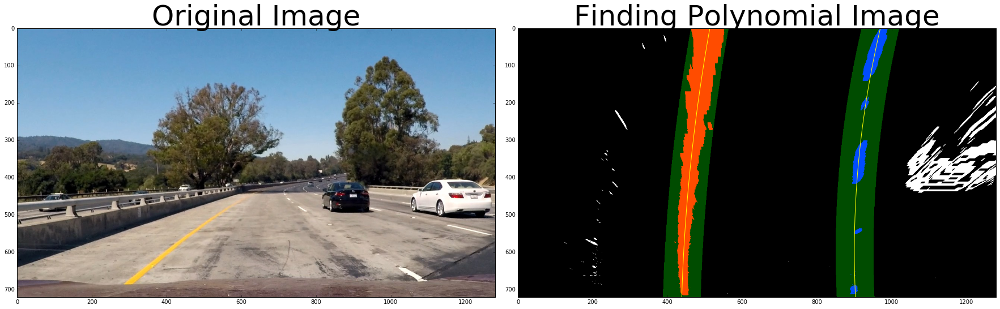

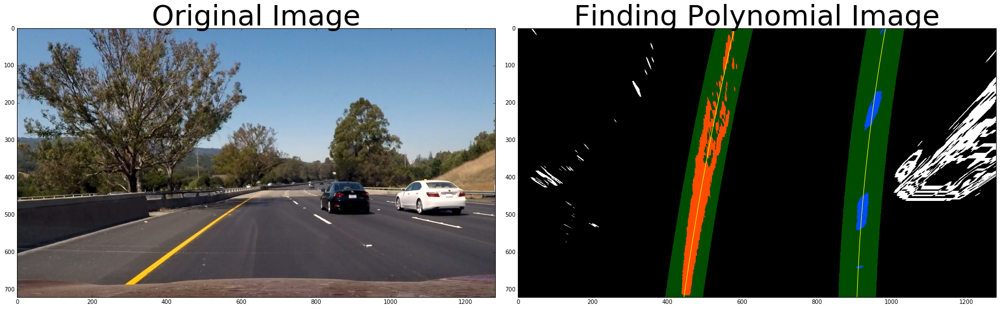

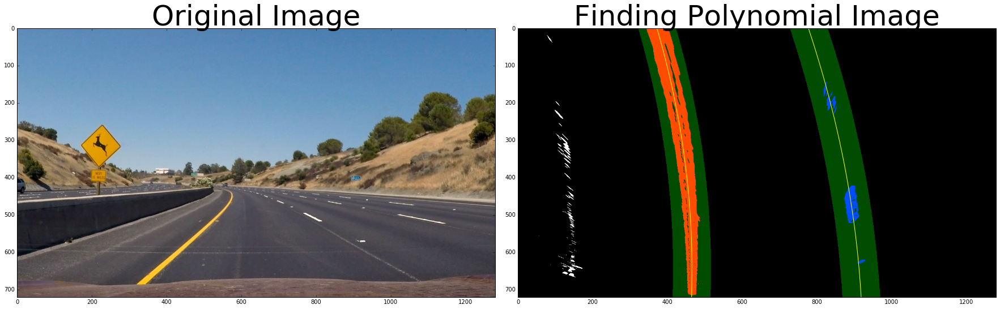

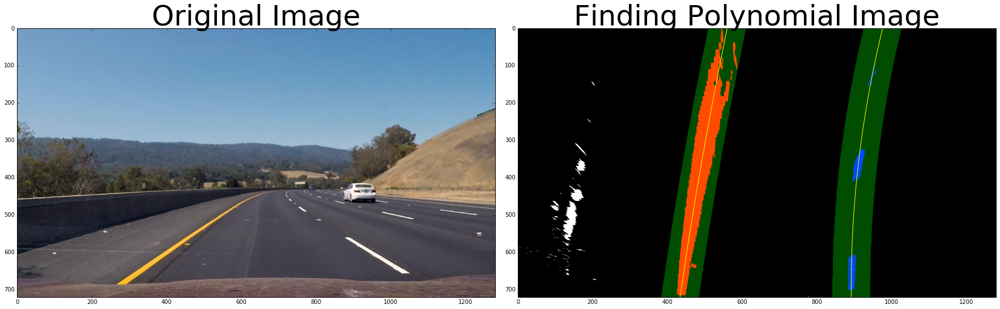

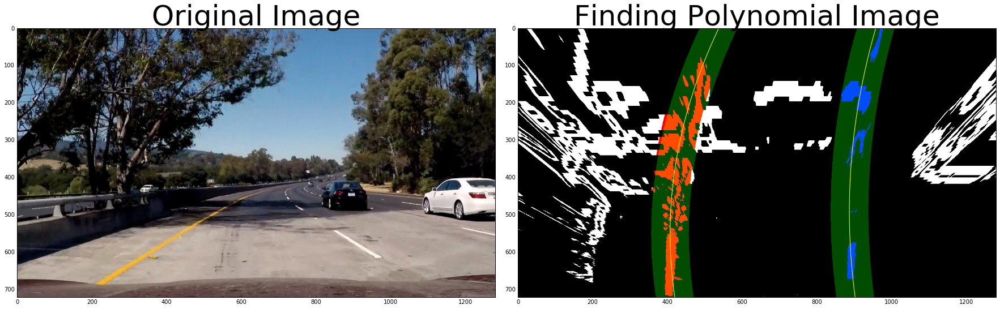

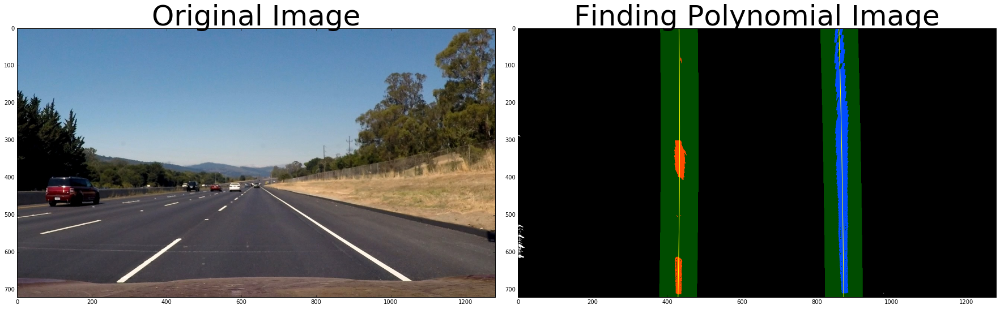

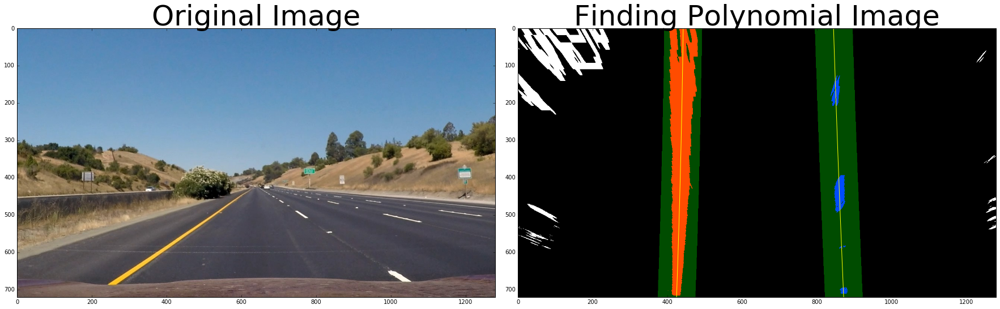

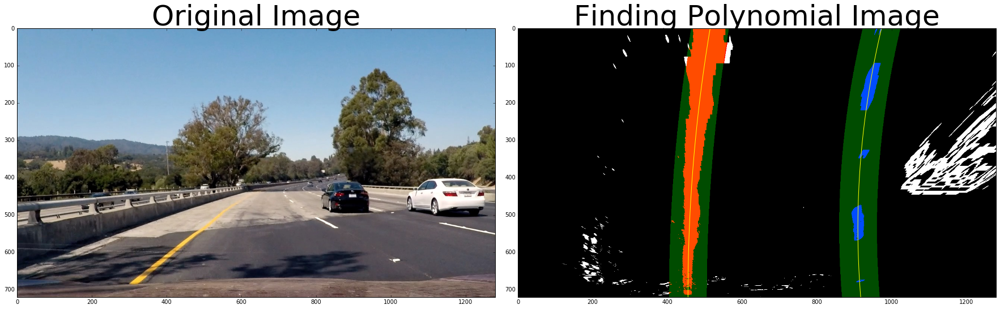

In [10]:
def search_around_poly_verbose(binary_warped, leftx, lefty, rightx, righty):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 50

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result
        
if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)

        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        test, Minv = Warp(Pipeline(image))
        leftx, lefty, rightx, righty = find_lane_pixels(test)
        result = search_around_poly_verbose(test, leftx,lefty, rightx, righty)
        ax2.imshow(result)
        ax2.set_title('Finding Polynomial Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.show()

In [11]:
def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 50

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    return (leftx, lefty, rightx, righty)


In [12]:

image = mping.imread(test_images[0])

binaryWarped, Minv = Warp(Pipeline(image))
warped = binaryWarped
leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)

left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

ploty = np.linspace(0, image.shape[0]-1, image.shape[0])
y_eval = image.shape[0]
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image

##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
left_curverad = ((1+(2*left_fit[0]*y_eval+left_fit[1])**2)**(3/2))/(np.abs(2*left_fit[0]))  ## Implement the calculation of the left line here
right_curverad = ((1+(2*right_fit[0]*y_eval+right_fit[1])**2)**(3/2))/(np.abs(2*right_fit[0]))  ## Implement the calculation of the right line here
    
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48


def getCurvature(x, y, y_eval):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    y_eval = ym_per_pix* y_eval
    
    fit = np.polyfit(y*ym_per_pix, x*xm_per_pix, 2)
    
    # Calculate radii of curvature
    curverad = ((1 + (2*fit[0]*y_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    return (curverad)

print("Average Curvature m")
print((getCurvature(leftx, lefty, np.max(ploty))+ getCurvature(rightx, righty, np.max(ploty)))/2.0)

4841.174114358699 2586.438356219297
Average Curvature m
1217.3942316633866


In [13]:
def getCenterOffset(left_fitx, right_fitx, center):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    lane_center = (left_fitx[-1] + right_fitx[-1]) / 2.0
    return((lane_center - center) * xm_per_pix)

In [ ]:
#Final Test

image = mping.imread(test_images[0])

binaryWarped, Minv = Warp(Pipeline(image))
leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)

left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

leftx, lefty, rightx, righty = search_around_poly(binaryWarped, left_fit, right_fit)

left_fitx, right_fitx, ploty = fit_poly(binaryWarped.shape, leftx, lefty, rightx, righty)
# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

color_warp[lefty, leftx] = [255, 0, 0]
color_warp[righty, rightx] = [0, 0, 255]
    
# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

# Combine the result with the original image
result = cv2.addWeighted(image, 1, newwarp, 1.0, 0)
plt.imshow(result)
plt.show()

if(PERFORMONPICTURES):
    for fname in test_images:
        image = mping.imread(fname)
        
        binaryWarped, Minv = Warp(Pipeline(image))
        warped = binaryWarped
        leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)
        
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        leftx, lefty, rightx, righty = search_around_poly(binaryWarped, left_fit, right_fit)

        left_fitx, right_fitx, ploty = fit_poly(warped.shape, leftx, lefty, rightx, righty)

        # Create an image to draw the lines on
        warp_zero = np.zeros_like(warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

        # Combine the result with the original image
        result = cv2.addWeighted(image, 1, newwarp, 1.0, 0)
        
        avgCurvature = (getCurvature(leftx, lefty, np.max(ploty))+ getCurvature(rightx, righty, np.max(ploty)))/2.0
        print("Left Curvature: ",getCurvature(leftx, lefty, np.max(ploty)))
        print("Right Curvature: ",getCurvature(rightx, righty, np.max(ploty)))
        
        curvature = "Estimated lane curvature %.2fm" % avgCurvature
        distance_center = "Estimated offset from lane center %.2fm" % (getCenterOffset(left_fitx, right_fitx, result.shape[1]/2.0))
        
        font = cv2.FONT_HERSHEY_COMPLEX
        cv2.putText(result, curvature, (30,60), font, 1.5, (255,0,0), 2)
        cv2.putText(result, distance_center, (30,120), font, 1, (255,0,0), 2)      
        
        plt.imshow(result)
        plt.show()
        

In [14]:
import collections

#Create pipeline for video
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.minPoints = 10
        self.nFilterFrames = 5
        
        # Is first Frame
        self.FirstFrame = True
        # was the line detected in last iteration
        self.detected = False
        
        # is line detected for current iteration
        self.valid = False
        
        #radius of curvature of the line in some units
        self.radius_of_curvature = collections.deque(maxlen=self.nFilterFrames)
       
        # running average of polynomials
        self.allPolys = collections.deque(maxlen=self.nFilterFrames)

        
    def getBestFit(self):
        print("Number of Lines = ",len(self.allPolys))
        return np.mean(self.allPolys, axis = 0)
    
    def addPoly(self, fit, curvature):
        self.valid = True
        self.allPolys.append(fit)
        self.radius_of_curvature.append(curvature)
    
    def getCurvature(self):
        return np.mean(self.radius_of_curvature)
    
def VideoPipeline(img):
    global LeftLine
    global RightLine
    
    binaryWarped, Minv = Warp(Pipeline(img))
    
    ploty = np.linspace(0, binaryWarped.shape[0]-1, binaryWarped.shape[0])
    
    if(LeftLine.detected & RightLine.detected):
        left_fitx = LeftLine.getBestFit()
        right_fitx = RightLine.getBestFit()
        leftx, lefty, rightx, righty = search_around_poly(binaryWarped, left_fitx, right_fitx)
    else:
        leftx, lefty, rightx, righty = find_lane_pixels(binaryWarped)
    
    # Check if we found enough points
    if (rightx.size > RightLine.minPoints):
        RightLine.detected = True
    else:
        RightLine.detected = False
    if (leftx.size > LeftLine.minPoints):
        LeftLine.detected = True
    else:
        LeftLine.detected = False
        
    if(RightLine.detected & LeftLine.detected):
        if(RightLine.FirstFrame | LeftLine.FirstFrame):
            RightLine.FirstFrame = False
            LeftLine.FirstFrame = False
            
            leftCurve = getCurvature(leftx, lefty, 719)
            rightCurve = getCurvature(rightx, righty, 719)
            
            left_fit = np.polyfit(lefty, leftx, 2)
            right_fit = np.polyfit(righty, rightx, 2)
            
            LeftLine.addPoly(left_fit, leftCurve)
            RightLine.addPoly(right_fit, rightCurve)
        else:
            leftCurve = getCurvature(leftx, lefty, 719)
            rightCurve = getCurvature(rightx, righty, 719)
            # make sure curvature is close
            if (abs((min(leftCurve, rightCurve) / max(leftCurve, rightCurve))) > 0.4):
                left_fit = np.polyfit(lefty, leftx, 2)
                right_fit = np.polyfit(righty, rightx, 2)
                # make sure polynomial is in same direction
                if((left_fit[0] * right_fit[0]) > 0):
                    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
                    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

                    LeftLine.addPoly(left_fit, leftCurve)
                    RightLine.addPoly(right_fit, rightCurve)
                else:
                    print("Skipping Frame Polynomial")
                    LeftLine.valid = False
                    RightLine.valid = False
            else:
                print("Skipping Frame Curvature")
                LeftLine.valid = False
                RightLine.valid = False
    
    if (RightLine.FirstFrame & (not RightLine.detected) | LeftLine.FirstFrame & (not LeftLine.detected)):
        # Skip
        return image
    elif(not LeftLine.valid):
        left_fit = LeftLine.getBestFit()
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fit = RightLine.getBestFit()
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    else:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binaryWarped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 

    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 1.0, 0)

    curv = (LeftLine.getCurvature() + RightLine.getCurvature())/2.0
    curvature = "Estimated lane curvature %.2fm" % (curv)

    distance_center = "Estimated offset from lane center %.2fm" % (getCenterOffset(left_fitx, right_fitx, result.shape[1]/2.0))

    font = cv2.FONT_HERSHEY_COMPLEX
    cv2.putText(result, curvature, (30,60), font, 1.5, (255,0,0), 2)
    cv2.putText(result, distance_center, (30,120), font, 1, (255,0,0), 2)
        
    return result



In [15]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

LeftLine = Line()
RightLine = Line()
    
write_output = 'result.mp4'
#clip1 = VideoFileClip("project_video.mp4")
clip1 = VideoFileClip("project_video.mp4")
write_clip = clip1.fl_image(VideoPipeline)
%time write_clip.write_videofile(write_output, audio=False)

[MoviePy] >>>> Building video result.mp4
[MoviePy] Writing video result.mp4


  0%|          | 1/1261 [00:00<15:19,  1.37it/s]

Number of Lines =  1
Number of Lines =  1


  0%|          | 2/1261 [00:01<15:03,  1.39it/s]

Number of Lines =  2
Number of Lines =  2
Skipping Frame Curvature
Number of Lines =  2
Number of Lines =  2


  0%|          | 3/1261 [00:02<14:56,  1.40it/s]

Number of Lines =  2
Number of Lines =  2


  0%|          | 4/1261 [00:02<15:05,  1.39it/s]

Number of Lines =  3
Number of Lines =  3


  0%|          | 5/1261 [00:03<15:00,  1.40it/s]

Number of Lines =  4
Number of Lines =  4


  0%|          | 6/1261 [00:04<14:58,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 7/1261 [00:05<14:58,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 8/1261 [00:05<14:54,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 9/1261 [00:06<14:51,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 10/1261 [00:07<14:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 11/1261 [00:07<14:51,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 12/1261 [00:08<14:53,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 13/1261 [00:09<14:52,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 14/1261 [00:10<14:52,  1.40it/s]

Number of Lines =  5
Number of Lines =  5


  1%|          | 15/1261 [00:10<14:53,  1.39it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  1%|▏         | 16/1261 [00:11<14:51,  1.40it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  1%|▏         | 17/1261 [00:12<14:49,  1.40it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  1%|▏         | 18/1261 [00:12<14:47,  1.40it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  2%|▏         | 19/1261 [00:13<14:45,  1.40it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  2%|▏         | 20/1261 [00:14<14:44,  1.40it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  2%|▏         | 21/1261 [00:14<14:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  2%|▏         | 22/1261 [00:15<14:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 23/1261 [00:16<14:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 24/1261 [00:17<14:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 25/1261 [00:17<14:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 26/1261 [00:18<14:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 27/1261 [00:19<14:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 28/1261 [00:19<14:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 29/1261 [00:20<14:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 30/1261 [00:21<14:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  2%|▏         | 31/1261 [00:21<14:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 32/1261 [00:22<14:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 33/1261 [00:23<14:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 34/1261 [00:24<14:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 35/1261 [00:24<14:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 36/1261 [00:25<14:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 37/1261 [00:26<14:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 38/1261 [00:26<14:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 39/1261 [00:27<14:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 40/1261 [00:28<14:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 41/1261 [00:28<14:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  3%|▎         | 42/1261 [00:29<14:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  3%|▎         | 43/1261 [00:30<14:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  3%|▎         | 44/1261 [00:31<14:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  4%|▎         | 45/1261 [00:31<14:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  4%|▎         | 46/1261 [00:32<14:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  4%|▎         | 47/1261 [00:33<14:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 48/1261 [00:33<14:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 49/1261 [00:34<14:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 50/1261 [00:35<14:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 51/1261 [00:36<14:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 52/1261 [00:36<14:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 53/1261 [00:37<14:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 54/1261 [00:38<14:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 55/1261 [00:38<14:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  4%|▍         | 56/1261 [00:39<14:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▍         | 57/1261 [00:40<14:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▍         | 58/1261 [00:41<14:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▍         | 59/1261 [00:41<14:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▍         | 60/1261 [00:42<14:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▍         | 61/1261 [00:43<14:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▍         | 62/1261 [00:43<14:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▍         | 63/1261 [00:44<14:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▌         | 64/1261 [00:45<14:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▌         | 65/1261 [00:45<14:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  5%|▌         | 66/1261 [00:46<14:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▌         | 67/1261 [00:47<14:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  5%|▌         | 68/1261 [00:48<14:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  5%|▌         | 69/1261 [00:48<14:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  6%|▌         | 70/1261 [00:49<14:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 71/1261 [00:50<14:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 72/1261 [00:50<14:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 73/1261 [00:51<14:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 74/1261 [00:52<14:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 75/1261 [00:53<14:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 76/1261 [00:53<13:59,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 77/1261 [00:54<13:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▌         | 78/1261 [00:55<13:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  6%|▋         | 79/1261 [00:55<13:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  6%|▋         | 80/1261 [00:56<13:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  6%|▋         | 81/1261 [00:57<13:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


  7%|▋         | 82/1261 [00:58<13:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 83/1261 [00:58<13:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 84/1261 [00:59<13:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 85/1261 [01:00<13:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 86/1261 [01:00<13:52,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 87/1261 [01:01<13:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 88/1261 [01:02<13:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 89/1261 [01:03<13:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 90/1261 [01:03<13:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 91/1261 [01:04<13:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 92/1261 [01:05<13:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 93/1261 [01:05<13:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  7%|▋         | 94/1261 [01:06<13:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 95/1261 [01:07<13:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 96/1261 [01:08<13:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 97/1261 [01:08<13:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 98/1261 [01:09<13:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 99/1261 [01:10<13:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 100/1261 [01:10<13:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 101/1261 [01:11<13:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 102/1261 [01:12<13:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 103/1261 [01:12<13:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 104/1261 [01:13<13:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  8%|▊         | 105/1261 [01:14<13:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  8%|▊         | 106/1261 [01:14<13:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  8%|▊         | 107/1261 [01:15<13:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▊         | 108/1261 [01:16<13:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▊         | 109/1261 [01:17<13:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▊         | 110/1261 [01:17<13:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 111/1261 [01:18<13:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 112/1261 [01:19<13:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 113/1261 [01:19<13:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 114/1261 [01:20<13:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 115/1261 [01:21<13:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


  9%|▉         | 116/1261 [01:22<13:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  9%|▉         | 117/1261 [01:22<13:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  9%|▉         | 118/1261 [01:23<13:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


  9%|▉         | 119/1261 [01:24<13:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 10%|▉         | 120/1261 [01:24<13:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 121/1261 [01:25<13:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 122/1261 [01:26<13:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 123/1261 [01:27<13:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 124/1261 [01:27<13:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 125/1261 [01:28<13:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|▉         | 126/1261 [01:29<13:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 127/1261 [01:29<13:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 128/1261 [01:30<13:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 129/1261 [01:31<13:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 130/1261 [01:32<13:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 131/1261 [01:32<13:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 10%|█         | 132/1261 [01:33<13:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 11%|█         | 133/1261 [01:34<13:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 11%|█         | 134/1261 [01:34<13:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 135/1261 [01:35<13:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 136/1261 [01:36<13:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 137/1261 [01:36<13:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 138/1261 [01:37<13:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 139/1261 [01:38<13:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 140/1261 [01:39<13:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█         | 141/1261 [01:39<13:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█▏        | 142/1261 [01:40<13:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 11%|█▏        | 143/1261 [01:41<13:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 11%|█▏        | 144/1261 [01:41<13:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 11%|█▏        | 145/1261 [01:42<13:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 146/1261 [01:43<13:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 147/1261 [01:43<13:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 148/1261 [01:44<13:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 149/1261 [01:45<13:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 150/1261 [01:46<13:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 151/1261 [01:46<13:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 152/1261 [01:47<13:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 153/1261 [01:48<13:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 154/1261 [01:48<13:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 155/1261 [01:49<13:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 156/1261 [01:50<13:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 12%|█▏        | 157/1261 [01:50<13:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 158/1261 [01:51<13:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 159/1261 [01:52<13:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 160/1261 [01:53<12:59,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 161/1261 [01:53<12:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 162/1261 [01:54<12:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 163/1261 [01:55<12:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 164/1261 [01:56<12:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 165/1261 [01:56<12:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 166/1261 [01:57<12:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 167/1261 [01:58<12:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 168/1261 [01:58<12:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 169/1261 [01:59<12:52,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 13%|█▎        | 170/1261 [02:00<12:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 14%|█▎        | 171/1261 [02:00<12:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 14%|█▎        | 172/1261 [02:01<12:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 14%|█▎        | 173/1261 [02:02<12:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 174/1261 [02:03<12:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 175/1261 [02:03<12:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 176/1261 [02:04<12:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 177/1261 [02:05<12:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 178/1261 [02:05<12:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 179/1261 [02:06<12:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 180/1261 [02:07<12:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 181/1261 [02:07<12:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 14%|█▍        | 182/1261 [02:08<12:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 183/1261 [02:09<12:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 184/1261 [02:10<12:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 185/1261 [02:10<12:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 186/1261 [02:11<12:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 187/1261 [02:12<12:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 188/1261 [02:13<12:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▍        | 189/1261 [02:13<12:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 190/1261 [02:14<12:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 191/1261 [02:15<12:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 192/1261 [02:15<12:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 193/1261 [02:16<12:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 194/1261 [02:17<12:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 15%|█▌        | 195/1261 [02:18<12:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 196/1261 [02:18<12:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 197/1261 [02:19<12:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 198/1261 [02:20<12:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 199/1261 [02:20<12:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 200/1261 [02:21<12:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 201/1261 [02:22<12:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 202/1261 [02:23<12:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 203/1261 [02:23<12:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▌        | 204/1261 [02:24<12:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▋        | 205/1261 [02:25<12:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 16%|█▋        | 206/1261 [02:25<12:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 16%|█▋        | 207/1261 [02:26<12:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 16%|█▋        | 208/1261 [02:27<12:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 209/1261 [02:27<12:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 210/1261 [02:28<12:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 211/1261 [02:29<12:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 212/1261 [02:30<12:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 213/1261 [02:30<12:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 214/1261 [02:31<12:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 215/1261 [02:32<12:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 216/1261 [02:33<12:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 217/1261 [02:33<12:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 218/1261 [02:34<12:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 219/1261 [02:35<12:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 17%|█▋        | 220/1261 [02:35<12:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 221/1261 [02:36<12:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 222/1261 [02:37<12:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 223/1261 [02:37<12:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 224/1261 [02:38<12:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 225/1261 [02:39<12:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 226/1261 [02:40<12:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 227/1261 [02:40<12:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 228/1261 [02:41<12:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 229/1261 [02:42<12:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 230/1261 [02:42<12:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 231/1261 [02:43<12:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 232/1261 [02:44<12:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 18%|█▊        | 233/1261 [02:44<12:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▊        | 234/1261 [02:45<12:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▊        | 235/1261 [02:46<12:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▊        | 236/1261 [02:46<12:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 237/1261 [02:47<12:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 238/1261 [02:48<12:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 239/1261 [02:49<12:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 240/1261 [02:49<12:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 241/1261 [02:50<12:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 242/1261 [02:51<12:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 243/1261 [02:51<12:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 244/1261 [02:52<11:59,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 19%|█▉        | 245/1261 [02:53<11:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 246/1261 [02:53<11:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 247/1261 [02:54<11:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 248/1261 [02:55<11:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 249/1261 [02:56<11:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 250/1261 [02:56<11:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 251/1261 [02:57<11:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|█▉        | 252/1261 [02:58<11:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|██        | 253/1261 [02:58<11:52,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|██        | 254/1261 [02:59<11:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|██        | 255/1261 [03:00<11:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 20%|██        | 256/1261 [03:00<11:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 20%|██        | 257/1261 [03:01<11:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 20%|██        | 258/1261 [03:02<11:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 259/1261 [03:03<11:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 260/1261 [03:03<11:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 261/1261 [03:04<11:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 262/1261 [03:05<11:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 263/1261 [03:05<11:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 264/1261 [03:06<11:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██        | 265/1261 [03:07<11:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 21%|██        | 266/1261 [03:07<11:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 21%|██        | 267/1261 [03:08<11:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██▏       | 268/1261 [03:09<11:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 21%|██▏       | 269/1261 [03:10<11:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██▏       | 270/1261 [03:10<11:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 21%|██▏       | 271/1261 [03:11<11:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 272/1261 [03:12<11:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 273/1261 [03:12<11:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 274/1261 [03:13<11:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 275/1261 [03:14<11:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 276/1261 [03:14<11:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 277/1261 [03:15<11:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 278/1261 [03:16<11:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 279/1261 [03:17<11:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 280/1261 [03:17<11:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 281/1261 [03:18<11:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 282/1261 [03:19<11:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 22%|██▏       | 283/1261 [03:19<11:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 284/1261 [03:20<11:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 285/1261 [03:21<11:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 286/1261 [03:21<11:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 287/1261 [03:22<11:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 288/1261 [03:23<11:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 289/1261 [03:24<11:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 290/1261 [03:24<11:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 291/1261 [03:25<11:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 292/1261 [03:26<11:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 293/1261 [03:26<11:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 294/1261 [03:27<11:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 295/1261 [03:28<11:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 23%|██▎       | 296/1261 [03:29<11:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▎       | 297/1261 [03:29<11:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▎       | 298/1261 [03:30<11:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▎       | 299/1261 [03:31<11:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 300/1261 [03:31<11:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 301/1261 [03:32<11:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 302/1261 [03:33<11:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 303/1261 [03:33<11:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 304/1261 [03:34<11:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 305/1261 [03:35<11:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 306/1261 [03:36<11:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 307/1261 [03:36<11:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 24%|██▍       | 308/1261 [03:37<11:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 309/1261 [03:38<11:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 310/1261 [03:38<11:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 311/1261 [03:39<11:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 312/1261 [03:40<11:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 313/1261 [03:41<11:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 314/1261 [03:41<11:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▍       | 315/1261 [03:42<11:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 316/1261 [03:43<11:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 317/1261 [03:43<11:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 318/1261 [03:44<11:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 319/1261 [03:45<11:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 320/1261 [03:45<11:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 25%|██▌       | 321/1261 [03:46<11:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 322/1261 [03:47<11:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 323/1261 [03:48<11:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 324/1261 [03:48<11:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 325/1261 [03:49<11:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 326/1261 [03:50<11:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 327/1261 [03:50<10:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 328/1261 [03:51<10:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 329/1261 [03:52<10:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 330/1261 [03:53<10:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▌       | 331/1261 [03:53<10:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 26%|██▋       | 332/1261 [03:54<10:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 26%|██▋       | 333/1261 [03:55<10:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 26%|██▋       | 334/1261 [03:55<10:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 335/1261 [03:56<10:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 336/1261 [03:57<10:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 337/1261 [03:58<10:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 338/1261 [03:58<10:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 339/1261 [03:59<10:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 340/1261 [04:00<10:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 341/1261 [04:00<10:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 342/1261 [04:01<10:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 343/1261 [04:02<10:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 344/1261 [04:02<10:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 345/1261 [04:03<10:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 27%|██▋       | 346/1261 [04:04<10:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 347/1261 [04:05<10:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 348/1261 [04:05<10:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 349/1261 [04:06<10:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 350/1261 [04:07<10:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 351/1261 [04:07<10:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 352/1261 [04:08<10:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 353/1261 [04:09<10:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 354/1261 [04:10<10:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 355/1261 [04:10<10:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 356/1261 [04:11<10:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 357/1261 [04:12<10:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 358/1261 [04:12<10:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 28%|██▊       | 359/1261 [04:13<10:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 29%|██▊       | 360/1261 [04:14<10:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 29%|██▊       | 361/1261 [04:14<10:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 29%|██▊       | 362/1261 [04:15<10:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 363/1261 [04:16<10:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 364/1261 [04:17<10:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 365/1261 [04:17<10:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 366/1261 [04:18<10:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 367/1261 [04:19<10:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 368/1261 [04:19<10:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 369/1261 [04:20<10:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 370/1261 [04:21<10:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 29%|██▉       | 371/1261 [04:21<10:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 372/1261 [04:22<10:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 373/1261 [04:23<10:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 374/1261 [04:24<10:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 375/1261 [04:24<10:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 376/1261 [04:25<10:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 377/1261 [04:26<10:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 30%|██▉       | 378/1261 [04:26<10:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 30%|███       | 379/1261 [04:27<10:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 30%|███       | 380/1261 [04:28<10:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 30%|███       | 381/1261 [04:28<10:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 30%|███       | 382/1261 [04:29<10:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 30%|███       | 383/1261 [04:30<10:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 30%|███       | 384/1261 [04:30<10:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 385/1261 [04:31<10:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 386/1261 [04:32<10:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 387/1261 [04:33<10:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 388/1261 [04:33<10:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 389/1261 [04:34<10:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 31%|███       | 390/1261 [04:35<10:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 31%|███       | 391/1261 [04:35<10:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 392/1261 [04:36<10:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 393/1261 [04:37<10:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 31%|███       | 394/1261 [04:38<10:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 31%|███▏      | 395/1261 [04:38<10:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 31%|███▏      | 396/1261 [04:39<10:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 31%|███▏      | 397/1261 [04:40<10:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 398/1261 [04:40<10:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 399/1261 [04:41<10:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 400/1261 [04:42<10:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 401/1261 [04:42<10:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 402/1261 [04:43<10:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 403/1261 [04:44<10:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 404/1261 [04:45<10:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 405/1261 [04:45<10:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 406/1261 [04:46<10:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 407/1261 [04:47<10:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 408/1261 [04:47<10:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 32%|███▏      | 409/1261 [04:48<10:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 410/1261 [04:49<10:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 411/1261 [04:49<09:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 412/1261 [04:50<09:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 413/1261 [04:51<09:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 414/1261 [04:52<09:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 415/1261 [04:52<09:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 416/1261 [04:53<09:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 417/1261 [04:54<09:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 418/1261 [04:54<09:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 419/1261 [04:55<09:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 420/1261 [04:56<09:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 421/1261 [04:57<09:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 33%|███▎      | 422/1261 [04:57<09:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 34%|███▎      | 423/1261 [04:58<09:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▎      | 424/1261 [04:59<09:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▎      | 425/1261 [04:59<09:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 426/1261 [05:00<09:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 427/1261 [05:01<09:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 428/1261 [05:01<09:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 429/1261 [05:02<09:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 430/1261 [05:03<09:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 431/1261 [05:04<09:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 432/1261 [05:04<09:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 433/1261 [05:05<09:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 434/1261 [05:06<09:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 34%|███▍      | 435/1261 [05:06<09:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 436/1261 [05:07<09:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 437/1261 [05:08<09:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 438/1261 [05:08<09:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 439/1261 [05:09<09:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 440/1261 [05:10<09:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 35%|███▍      | 441/1261 [05:11<09:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 442/1261 [05:11<09:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 443/1261 [05:12<09:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 444/1261 [05:13<09:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 445/1261 [05:13<09:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 446/1261 [05:14<09:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 35%|███▌      | 447/1261 [05:15<09:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 448/1261 [05:15<09:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 449/1261 [05:16<09:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 450/1261 [05:17<09:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 451/1261 [05:18<09:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 452/1261 [05:18<09:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 453/1261 [05:19<09:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 454/1261 [05:20<09:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 455/1261 [05:20<09:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 456/1261 [05:21<09:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 36%|███▌      | 457/1261 [05:22<09:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▋      | 458/1261 [05:22<09:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▋      | 459/1261 [05:23<09:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 36%|███▋      | 460/1261 [05:24<09:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 461/1261 [05:25<09:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 462/1261 [05:25<09:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 463/1261 [05:26<09:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 464/1261 [05:27<09:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 465/1261 [05:27<09:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 466/1261 [05:28<09:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 467/1261 [05:29<09:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 468/1261 [05:29<09:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 469/1261 [05:30<09:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 470/1261 [05:31<09:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 471/1261 [05:32<09:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 37%|███▋      | 472/1261 [05:32<09:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 473/1261 [05:33<09:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 474/1261 [05:34<09:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 475/1261 [05:34<09:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 476/1261 [05:35<09:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 477/1261 [05:36<09:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 478/1261 [05:37<09:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 479/1261 [05:37<09:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 480/1261 [05:38<09:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 481/1261 [05:39<09:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 482/1261 [05:39<09:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 483/1261 [05:40<09:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 484/1261 [05:41<09:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 38%|███▊      | 485/1261 [05:41<09:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▊      | 486/1261 [05:42<09:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 39%|███▊      | 487/1261 [05:43<09:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▊      | 488/1261 [05:44<09:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 489/1261 [05:44<09:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 490/1261 [05:45<09:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 491/1261 [05:46<09:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 492/1261 [05:46<09:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 493/1261 [05:47<09:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 494/1261 [05:48<09:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 495/1261 [05:49<09:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 496/1261 [05:49<08:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 497/1261 [05:50<08:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 39%|███▉      | 498/1261 [05:51<08:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 499/1261 [05:51<08:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 500/1261 [05:52<08:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 501/1261 [05:53<08:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 502/1261 [05:53<08:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 503/1261 [05:54<08:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 40%|███▉      | 504/1261 [05:55<08:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 505/1261 [05:56<08:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 506/1261 [05:56<08:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 507/1261 [05:57<08:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 508/1261 [05:58<08:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 509/1261 [05:58<08:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 40%|████      | 510/1261 [05:59<08:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 41%|████      | 511/1261 [06:00<08:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████      | 512/1261 [06:01<08:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████      | 513/1261 [06:01<08:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████      | 514/1261 [06:02<08:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████      | 515/1261 [06:03<08:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 41%|████      | 516/1261 [06:03<08:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████      | 517/1261 [06:04<08:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 41%|████      | 518/1261 [06:05<08:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 41%|████      | 519/1261 [06:05<08:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 41%|████      | 520/1261 [06:06<08:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 41%|████▏     | 521/1261 [06:07<08:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████▏     | 522/1261 [06:08<08:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 41%|████▏     | 523/1261 [06:08<08:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 524/1261 [06:09<08:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 525/1261 [06:10<08:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 526/1261 [06:10<08:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 527/1261 [06:11<08:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 528/1261 [06:12<08:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 529/1261 [06:12<08:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 530/1261 [06:13<08:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 531/1261 [06:14<08:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 532/1261 [06:15<08:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 533/1261 [06:15<08:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 534/1261 [06:16<08:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 42%|████▏     | 535/1261 [06:17<08:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 536/1261 [06:17<08:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 537/1261 [06:18<08:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 538/1261 [06:19<08:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 539/1261 [06:20<08:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 540/1261 [06:20<08:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 541/1261 [06:21<08:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 542/1261 [06:22<08:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 543/1261 [06:22<08:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 544/1261 [06:23<08:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 545/1261 [06:24<08:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 546/1261 [06:25<08:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 547/1261 [06:25<08:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 43%|████▎     | 548/1261 [06:26<08:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 44%|████▎     | 549/1261 [06:27<08:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▎     | 550/1261 [06:27<08:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 44%|████▎     | 551/1261 [06:28<08:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 552/1261 [06:29<08:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 553/1261 [06:29<08:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 554/1261 [06:30<08:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 555/1261 [06:31<08:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 556/1261 [06:32<08:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 557/1261 [06:32<08:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 558/1261 [06:33<08:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 559/1261 [06:34<08:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 560/1261 [06:34<08:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 44%|████▍     | 561/1261 [06:35<08:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 562/1261 [06:36<08:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 563/1261 [06:36<08:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 564/1261 [06:37<08:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 565/1261 [06:38<08:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 566/1261 [06:39<08:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▍     | 567/1261 [06:39<08:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 568/1261 [06:40<08:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 569/1261 [06:41<08:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 570/1261 [06:41<08:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 571/1261 [06:42<08:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 572/1261 [06:43<08:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 45%|████▌     | 573/1261 [06:43<08:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 574/1261 [06:44<08:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 575/1261 [06:45<08:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 576/1261 [06:46<08:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 577/1261 [06:46<08:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 578/1261 [06:47<08:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 579/1261 [06:48<08:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 580/1261 [06:48<08:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 581/1261 [06:49<07:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 582/1261 [06:50<07:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 46%|████▌     | 583/1261 [06:51<07:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 46%|████▋     | 584/1261 [06:51<07:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 46%|████▋     | 585/1261 [06:52<07:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 46%|████▋     | 586/1261 [06:53<07:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 587/1261 [06:53<07:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 588/1261 [06:54<07:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 589/1261 [06:55<07:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 590/1261 [06:56<07:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 591/1261 [06:56<07:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 592/1261 [06:57<07:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 593/1261 [06:58<07:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 594/1261 [06:59<07:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 595/1261 [06:59<07:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 596/1261 [07:00<07:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 597/1261 [07:01<07:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 47%|████▋     | 598/1261 [07:01<07:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 599/1261 [07:02<07:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 600/1261 [07:03<07:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 601/1261 [07:03<07:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 602/1261 [07:04<07:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 603/1261 [07:05<07:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 604/1261 [07:06<07:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 605/1261 [07:06<07:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 606/1261 [07:07<07:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 607/1261 [07:08<07:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 608/1261 [07:08<07:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 609/1261 [07:09<07:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 610/1261 [07:10<07:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 48%|████▊     | 611/1261 [07:10<07:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Polynomial
Number of Lines =  5
Number of Lines =  5


 49%|████▊     | 612/1261 [07:11<07:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▊     | 613/1261 [07:12<07:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▊     | 614/1261 [07:13<07:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 615/1261 [07:13<07:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 616/1261 [07:14<07:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 617/1261 [07:15<07:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 618/1261 [07:15<07:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 619/1261 [07:16<07:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 620/1261 [07:17<07:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 621/1261 [07:17<07:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 622/1261 [07:18<07:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 623/1261 [07:19<07:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 49%|████▉     | 624/1261 [07:20<07:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 625/1261 [07:20<07:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 626/1261 [07:21<07:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 627/1261 [07:22<07:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 628/1261 [07:22<07:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 629/1261 [07:23<07:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|████▉     | 630/1261 [07:24<07:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|█████     | 631/1261 [07:25<07:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|█████     | 632/1261 [07:25<07:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|█████     | 633/1261 [07:26<07:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 50%|█████     | 634/1261 [07:27<07:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|█████     | 635/1261 [07:27<07:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 50%|█████     | 636/1261 [07:28<07:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 637/1261 [07:29<07:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 638/1261 [07:29<07:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 639/1261 [07:30<07:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 640/1261 [07:31<07:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 641/1261 [07:32<07:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 642/1261 [07:32<07:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 643/1261 [07:33<07:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████     | 644/1261 [07:34<07:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 51%|█████     | 645/1261 [07:34<07:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 51%|█████     | 646/1261 [07:35<07:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 51%|█████▏    | 647/1261 [07:36<07:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 51%|█████▏    | 648/1261 [07:36<07:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 51%|█████▏    | 649/1261 [07:37<07:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 650/1261 [07:38<07:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 651/1261 [07:39<07:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 652/1261 [07:39<07:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 653/1261 [07:40<07:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 654/1261 [07:41<07:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 655/1261 [07:41<07:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 656/1261 [07:42<07:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 657/1261 [07:43<07:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 658/1261 [07:44<07:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 659/1261 [07:44<07:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 660/1261 [07:45<07:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 661/1261 [07:46<07:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 52%|█████▏    | 662/1261 [07:46<07:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 663/1261 [07:47<07:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 664/1261 [07:48<07:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 665/1261 [07:49<07:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 666/1261 [07:49<06:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 667/1261 [07:50<06:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 668/1261 [07:51<06:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 669/1261 [07:51<06:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 670/1261 [07:52<06:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 671/1261 [07:53<06:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 672/1261 [07:53<06:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 673/1261 [07:54<06:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 53%|█████▎    | 674/1261 [07:55<06:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▎    | 675/1261 [07:55<06:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▎    | 676/1261 [07:56<06:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▎    | 677/1261 [07:57<06:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 678/1261 [07:58<06:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 679/1261 [07:58<06:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 680/1261 [07:59<06:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 681/1261 [08:00<06:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 682/1261 [08:01<06:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 683/1261 [08:01<06:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 684/1261 [08:02<06:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 685/1261 [08:03<06:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 686/1261 [08:03<06:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 54%|█████▍    | 687/1261 [08:04<06:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 688/1261 [08:05<06:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 689/1261 [08:06<06:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 690/1261 [08:06<06:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 691/1261 [08:07<06:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 692/1261 [08:08<06:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▍    | 693/1261 [08:08<06:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 694/1261 [08:09<06:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 695/1261 [08:10<06:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 696/1261 [08:10<06:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 697/1261 [08:11<06:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 698/1261 [08:12<06:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 55%|█████▌    | 699/1261 [08:13<06:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 700/1261 [08:13<06:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 701/1261 [08:14<06:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 702/1261 [08:15<06:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 703/1261 [08:15<06:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 704/1261 [08:16<06:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 705/1261 [08:17<06:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 706/1261 [08:17<06:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 707/1261 [08:18<06:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 708/1261 [08:19<06:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▌    | 709/1261 [08:20<06:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▋    | 710/1261 [08:20<06:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▋    | 711/1261 [08:21<06:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 56%|█████▋    | 712/1261 [08:22<06:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 713/1261 [08:22<06:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 714/1261 [08:23<06:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 715/1261 [08:24<06:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 716/1261 [08:24<06:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 717/1261 [08:25<06:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 718/1261 [08:26<06:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 719/1261 [08:27<06:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 720/1261 [08:27<06:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 721/1261 [08:28<06:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 722/1261 [08:29<06:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 723/1261 [08:29<06:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 724/1261 [08:30<06:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 57%|█████▋    | 725/1261 [08:31<06:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 726/1261 [08:31<06:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 727/1261 [08:32<06:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 728/1261 [08:33<06:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 729/1261 [08:34<06:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 730/1261 [08:34<06:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 731/1261 [08:35<06:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 732/1261 [08:36<06:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 733/1261 [08:36<06:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 734/1261 [08:37<06:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 735/1261 [08:38<06:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 736/1261 [08:38<06:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 58%|█████▊    | 737/1261 [08:39<06:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▊    | 738/1261 [08:40<06:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▊    | 739/1261 [08:41<06:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▊    | 740/1261 [08:41<06:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 741/1261 [08:42<06:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 742/1261 [08:43<06:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 743/1261 [08:43<06:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 744/1261 [08:44<06:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 745/1261 [08:45<06:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 746/1261 [08:46<06:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 747/1261 [08:46<06:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 748/1261 [08:47<06:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 749/1261 [08:48<06:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 59%|█████▉    | 750/1261 [08:48<06:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 751/1261 [08:49<05:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 752/1261 [08:50<05:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 753/1261 [08:50<05:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 754/1261 [08:51<05:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 755/1261 [08:52<05:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 60%|█████▉    | 756/1261 [08:52<05:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 60%|██████    | 757/1261 [08:53<05:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|██████    | 758/1261 [08:54<05:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|██████    | 759/1261 [08:55<05:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|██████    | 760/1261 [08:55<05:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|██████    | 761/1261 [08:56<05:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 60%|██████    | 762/1261 [08:57<05:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 763/1261 [08:58<05:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 764/1261 [08:58<05:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 61%|██████    | 765/1261 [08:59<05:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 766/1261 [09:00<05:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 767/1261 [09:00<05:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 768/1261 [09:01<05:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 769/1261 [09:02<05:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 770/1261 [09:03<05:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 771/1261 [09:03<05:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████    | 772/1261 [09:04<05:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████▏   | 773/1261 [09:05<05:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████▏   | 774/1261 [09:05<05:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 61%|██████▏   | 775/1261 [09:06<05:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 776/1261 [09:07<05:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 777/1261 [09:08<05:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 778/1261 [09:08<05:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 779/1261 [09:09<05:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 780/1261 [09:10<05:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 781/1261 [09:10<05:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 782/1261 [09:11<05:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 783/1261 [09:12<05:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 784/1261 [09:12<05:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 785/1261 [09:13<05:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 786/1261 [09:14<05:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 787/1261 [09:15<05:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 62%|██████▏   | 788/1261 [09:15<05:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 789/1261 [09:16<05:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 790/1261 [09:17<05:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 791/1261 [09:18<05:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 792/1261 [09:18<05:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 793/1261 [09:19<05:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 794/1261 [09:20<05:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 795/1261 [09:20<05:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 796/1261 [09:21<05:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 797/1261 [09:22<05:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 798/1261 [09:22<05:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 799/1261 [09:23<05:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 63%|██████▎   | 800/1261 [09:24<05:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▎   | 801/1261 [09:25<05:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▎   | 802/1261 [09:25<05:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▎   | 803/1261 [09:26<05:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 804/1261 [09:27<05:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 805/1261 [09:27<05:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 806/1261 [09:28<05:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 807/1261 [09:29<05:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 808/1261 [09:29<05:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 809/1261 [09:30<05:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 810/1261 [09:31<05:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 811/1261 [09:32<05:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 812/1261 [09:32<05:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 64%|██████▍   | 813/1261 [09:33<05:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 814/1261 [09:34<05:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 815/1261 [09:34<05:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 816/1261 [09:35<05:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 817/1261 [09:36<05:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 818/1261 [09:36<05:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▍   | 819/1261 [09:37<05:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 820/1261 [09:38<05:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 821/1261 [09:39<05:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 822/1261 [09:39<05:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 823/1261 [09:40<05:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 824/1261 [09:41<05:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 65%|██████▌   | 825/1261 [09:41<05:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 826/1261 [09:42<05:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 827/1261 [09:43<05:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 828/1261 [09:44<05:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 829/1261 [09:44<05:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 830/1261 [09:45<05:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 831/1261 [09:46<05:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 832/1261 [09:46<05:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 833/1261 [09:47<05:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 834/1261 [09:48<05:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▌   | 835/1261 [09:48<05:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▋   | 836/1261 [09:49<04:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▋   | 837/1261 [09:50<04:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 66%|██████▋   | 838/1261 [09:51<04:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 839/1261 [09:51<04:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 840/1261 [09:52<04:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 841/1261 [09:53<04:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 842/1261 [09:53<04:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 843/1261 [09:54<04:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 844/1261 [09:55<04:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 845/1261 [09:56<04:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 846/1261 [09:56<04:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 847/1261 [09:57<04:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 848/1261 [09:58<04:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 849/1261 [09:59<04:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 850/1261 [09:59<04:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 67%|██████▋   | 851/1261 [10:00<04:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 852/1261 [10:01<04:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 853/1261 [10:01<04:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 854/1261 [10:02<04:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 855/1261 [10:03<04:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 856/1261 [10:03<04:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 857/1261 [10:04<04:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 858/1261 [10:05<04:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 859/1261 [10:06<04:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 860/1261 [10:06<04:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 861/1261 [10:07<04:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 862/1261 [10:08<04:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 68%|██████▊   | 863/1261 [10:08<04:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▊   | 864/1261 [10:09<04:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▊   | 865/1261 [10:10<04:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▊   | 866/1261 [10:10<04:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 867/1261 [10:11<04:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 868/1261 [10:12<04:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 869/1261 [10:13<04:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 870/1261 [10:13<04:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 871/1261 [10:14<04:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 872/1261 [10:15<04:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 873/1261 [10:15<04:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 874/1261 [10:16<04:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 875/1261 [10:17<04:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 69%|██████▉   | 876/1261 [10:18<04:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 877/1261 [10:18<04:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 878/1261 [10:19<04:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 879/1261 [10:20<04:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 880/1261 [10:20<04:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 881/1261 [10:21<04:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|██████▉   | 882/1261 [10:22<04:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 883/1261 [10:22<04:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 884/1261 [10:23<04:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 885/1261 [10:24<04:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 886/1261 [10:25<04:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 887/1261 [10:25<04:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 70%|███████   | 888/1261 [10:26<04:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 70%|███████   | 889/1261 [10:27<04:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 71%|███████   | 890/1261 [10:27<04:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 71%|███████   | 891/1261 [10:28<04:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████   | 892/1261 [10:29<04:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████   | 893/1261 [10:30<04:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 71%|███████   | 894/1261 [10:30<04:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 71%|███████   | 895/1261 [10:31<04:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████   | 896/1261 [10:32<04:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████   | 897/1261 [10:32<04:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████   | 898/1261 [10:33<04:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████▏  | 899/1261 [10:34<04:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 71%|███████▏  | 900/1261 [10:34<04:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 71%|███████▏  | 901/1261 [10:35<04:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 902/1261 [10:36<04:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 903/1261 [10:37<04:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 904/1261 [10:37<04:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 905/1261 [10:38<04:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 906/1261 [10:39<04:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 907/1261 [10:39<04:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 908/1261 [10:40<04:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 909/1261 [10:41<04:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 910/1261 [10:41<04:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 911/1261 [10:42<04:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 912/1261 [10:43<04:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 913/1261 [10:44<04:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 72%|███████▏  | 914/1261 [10:44<04:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 915/1261 [10:45<04:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 916/1261 [10:46<04:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 917/1261 [10:46<04:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 918/1261 [10:47<04:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 919/1261 [10:48<04:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 920/1261 [10:49<04:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 921/1261 [10:49<03:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 922/1261 [10:50<03:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 923/1261 [10:51<03:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 924/1261 [10:51<03:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 925/1261 [10:52<03:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 73%|███████▎  | 926/1261 [10:53<03:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▎  | 927/1261 [10:54<03:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▎  | 928/1261 [10:54<03:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▎  | 929/1261 [10:55<03:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 930/1261 [10:56<03:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 931/1261 [10:56<03:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 932/1261 [10:57<03:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 933/1261 [10:58<03:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 934/1261 [10:59<03:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 935/1261 [10:59<03:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 936/1261 [11:00<03:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 937/1261 [11:01<03:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 938/1261 [11:01<03:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 74%|███████▍  | 939/1261 [11:02<03:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 940/1261 [11:03<03:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 941/1261 [11:04<03:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 942/1261 [11:04<03:45,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 943/1261 [11:05<03:44,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 944/1261 [11:06<03:43,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 75%|███████▍  | 945/1261 [11:06<03:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 946/1261 [11:07<03:42,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 947/1261 [11:08<03:41,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 948/1261 [11:08<03:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 949/1261 [11:09<03:40,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 950/1261 [11:10<03:39,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 951/1261 [11:11<03:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 75%|███████▌  | 952/1261 [11:12<03:38,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 953/1261 [11:12<03:37,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 954/1261 [11:13<03:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 955/1261 [11:14<03:36,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 956/1261 [11:15<03:35,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 957/1261 [11:15<03:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 958/1261 [11:16<03:34,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 959/1261 [11:17<03:33,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 960/1261 [11:18<03:32,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▌  | 961/1261 [11:18<03:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▋  | 962/1261 [11:19<03:31,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▋  | 963/1261 [11:20<03:30,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 76%|███████▋  | 964/1261 [11:20<03:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 965/1261 [11:21<03:29,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 966/1261 [11:22<03:28,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 967/1261 [11:23<03:27,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 968/1261 [11:23<03:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 969/1261 [11:24<03:26,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 970/1261 [11:25<03:25,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 971/1261 [11:25<03:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 972/1261 [11:26<03:24,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 973/1261 [11:27<03:23,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 974/1261 [11:28<03:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 975/1261 [11:28<03:22,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 976/1261 [11:29<03:21,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 77%|███████▋  | 977/1261 [11:30<03:20,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 978/1261 [11:30<03:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 979/1261 [11:31<03:19,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 980/1261 [11:32<03:18,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 981/1261 [11:32<03:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 982/1261 [11:33<03:17,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 983/1261 [11:34<03:16,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 984/1261 [11:35<03:15,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 985/1261 [11:35<03:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 986/1261 [11:36<03:14,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 987/1261 [11:37<03:13,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 988/1261 [11:37<03:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 78%|███████▊  | 989/1261 [11:38<03:12,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▊  | 990/1261 [11:39<03:11,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▊  | 991/1261 [11:40<03:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 79%|███████▊  | 992/1261 [11:40<03:10,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▊  | 993/1261 [11:41<03:09,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 994/1261 [11:42<03:08,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 995/1261 [11:42<03:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 996/1261 [11:43<03:07,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 997/1261 [11:44<03:06,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 998/1261 [11:44<03:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 999/1261 [11:45<03:05,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 1000/1261 [11:46<03:04,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 1001/1261 [11:47<03:03,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 79%|███████▉  | 1002/1261 [11:47<03:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1003/1261 [11:48<03:02,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1004/1261 [11:49<03:01,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1005/1261 [11:50<03:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1006/1261 [11:50<03:00,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1007/1261 [11:51<02:59,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|███████▉  | 1008/1261 [11:52<02:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1009/1261 [11:52<02:58,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1010/1261 [11:53<02:57,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1011/1261 [11:54<02:56,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1012/1261 [11:55<02:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1013/1261 [11:55<02:55,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1014/1261 [11:56<02:54,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 80%|████████  | 1015/1261 [11:57<02:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1016/1261 [11:57<02:53,  1.42it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1017/1261 [11:58<02:52,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1018/1261 [11:59<02:51,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1019/1261 [11:59<02:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1020/1261 [12:00<02:50,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1021/1261 [12:01<02:49,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1022/1261 [12:02<02:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1023/1261 [12:02<02:48,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████  | 1024/1261 [12:03<02:47,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████▏ | 1025/1261 [12:04<02:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████▏ | 1026/1261 [12:05<02:46,  1.42it/s]

Number of Lines =  5
Number of Lines =  5


 81%|████████▏ | 1027/1261 [12:05<02:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1028/1261 [12:06<02:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1029/1261 [12:07<02:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1030/1261 [12:07<02:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1031/1261 [12:08<02:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1032/1261 [12:09<02:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1033/1261 [12:10<02:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1034/1261 [12:10<02:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1035/1261 [12:11<02:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1036/1261 [12:12<02:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1037/1261 [12:12<02:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1038/1261 [12:13<02:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1039/1261 [12:14<02:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 82%|████████▏ | 1040/1261 [12:15<02:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1041/1261 [12:15<02:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1042/1261 [12:16<02:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1043/1261 [12:17<02:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1044/1261 [12:18<02:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1045/1261 [12:18<02:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1046/1261 [12:19<02:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1047/1261 [12:20<02:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1048/1261 [12:20<02:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1049/1261 [12:21<02:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1050/1261 [12:22<02:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1051/1261 [12:23<02:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 83%|████████▎ | 1052/1261 [12:23<02:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▎ | 1053/1261 [12:24<02:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▎ | 1054/1261 [12:25<02:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▎ | 1055/1261 [12:25<02:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▎ | 1056/1261 [12:26<02:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1057/1261 [12:27<02:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1058/1261 [12:28<02:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1059/1261 [12:28<02:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1060/1261 [12:29<02:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1061/1261 [12:30<02:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1062/1261 [12:30<02:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1063/1261 [12:31<02:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1064/1261 [12:32<02:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 84%|████████▍ | 1065/1261 [12:33<02:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1066/1261 [12:33<02:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1067/1261 [12:34<02:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1068/1261 [12:35<02:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1069/1261 [12:35<02:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1070/1261 [12:36<02:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▍ | 1071/1261 [12:37<02:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1072/1261 [12:38<02:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1073/1261 [12:38<02:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1074/1261 [12:39<02:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1075/1261 [12:40<02:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1076/1261 [12:41<02:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1077/1261 [12:41<02:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 85%|████████▌ | 1078/1261 [12:42<02:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1079/1261 [12:43<02:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1080/1261 [12:44<02:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1081/1261 [12:44<02:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1082/1261 [12:45<02:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1083/1261 [12:46<02:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1084/1261 [12:46<02:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1085/1261 [12:47<02:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1086/1261 [12:48<02:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▌ | 1087/1261 [12:48<02:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▋ | 1088/1261 [12:49<02:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▋ | 1089/1261 [12:50<02:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 86%|████████▋ | 1090/1261 [12:51<02:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1091/1261 [12:51<02:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1092/1261 [12:52<01:59,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1093/1261 [12:53<01:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1094/1261 [12:54<01:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1095/1261 [12:54<01:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1096/1261 [12:55<01:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1097/1261 [12:56<01:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1098/1261 [12:56<01:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1099/1261 [12:57<01:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1100/1261 [12:58<01:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1101/1261 [12:59<01:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1102/1261 [12:59<01:52,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 87%|████████▋ | 1103/1261 [13:00<01:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1104/1261 [13:01<01:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1105/1261 [13:01<01:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1106/1261 [13:02<01:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1107/1261 [13:03<01:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1108/1261 [13:04<01:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1109/1261 [13:04<01:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1110/1261 [13:05<01:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1111/1261 [13:06<01:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1112/1261 [13:06<01:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1113/1261 [13:07<01:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1114/1261 [13:08<01:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 88%|████████▊ | 1115/1261 [13:09<01:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 89%|████████▊ | 1116/1261 [13:09<01:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▊ | 1117/1261 [13:10<01:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▊ | 1118/1261 [13:11<01:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▊ | 1119/1261 [13:11<01:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1120/1261 [13:12<01:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1121/1261 [13:13<01:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1122/1261 [13:13<01:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1123/1261 [13:14<01:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1124/1261 [13:15<01:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1125/1261 [13:16<01:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1126/1261 [13:16<01:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1127/1261 [13:17<01:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 89%|████████▉ | 1128/1261 [13:18<01:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1129/1261 [13:18<01:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1130/1261 [13:19<01:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1131/1261 [13:20<01:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1132/1261 [13:21<01:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1133/1261 [13:21<01:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|████████▉ | 1134/1261 [13:22<01:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1135/1261 [13:23<01:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1136/1261 [13:23<01:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1137/1261 [13:24<01:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1138/1261 [13:25<01:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1139/1261 [13:25<01:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1140/1261 [13:26<01:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 90%|█████████ | 1141/1261 [13:27<01:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1142/1261 [13:28<01:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1143/1261 [13:28<01:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1144/1261 [13:29<01:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1145/1261 [13:30<01:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1146/1261 [13:30<01:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1147/1261 [13:31<01:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1148/1261 [13:32<01:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1149/1261 [13:33<01:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████ | 1150/1261 [13:33<01:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████▏| 1151/1261 [13:34<01:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 91%|█████████▏| 1152/1261 [13:35<01:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 91%|█████████▏| 1153/1261 [13:35<01:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1154/1261 [13:36<01:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1155/1261 [13:37<01:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1156/1261 [13:37<01:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1157/1261 [13:38<01:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1158/1261 [13:39<01:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1159/1261 [13:40<01:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1160/1261 [13:40<01:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1161/1261 [13:41<01:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1162/1261 [13:42<01:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1163/1261 [13:43<01:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1164/1261 [13:43<01:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1165/1261 [13:44<01:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 92%|█████████▏| 1166/1261 [13:45<01:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1167/1261 [13:46<01:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1168/1261 [13:46<01:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1169/1261 [13:47<01:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1170/1261 [13:48<01:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1171/1261 [13:48<01:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1172/1261 [13:49<01:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1173/1261 [13:50<01:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1174/1261 [13:50<01:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1175/1261 [13:51<01:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1176/1261 [13:52<01:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1177/1261 [13:53<00:59,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1178/1261 [13:53<00:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 93%|█████████▎| 1179/1261 [13:54<00:58,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▎| 1180/1261 [13:55<00:57,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▎| 1181/1261 [13:55<00:56,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▎| 1182/1261 [13:56<00:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1183/1261 [13:57<00:55,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1184/1261 [13:58<00:54,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1185/1261 [13:59<00:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1186/1261 [13:59<00:53,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1187/1261 [14:00<00:52,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1188/1261 [14:01<00:51,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1189/1261 [14:01<00:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1190/1261 [14:02<00:50,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 94%|█████████▍| 1191/1261 [14:03<00:49,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1192/1261 [14:03<00:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1193/1261 [14:04<00:48,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1194/1261 [14:05<00:47,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1195/1261 [14:06<00:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1196/1261 [14:06<00:46,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▍| 1197/1261 [14:07<00:45,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1198/1261 [14:08<00:44,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1199/1261 [14:08<00:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1200/1261 [14:09<00:43,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1201/1261 [14:10<00:42,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1202/1261 [14:11<00:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1203/1261 [14:11<00:41,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 95%|█████████▌| 1204/1261 [14:12<00:40,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1205/1261 [14:13<00:39,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1206/1261 [14:13<00:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1207/1261 [14:14<00:38,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1208/1261 [14:15<00:37,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1209/1261 [14:15<00:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1210/1261 [14:16<00:36,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1211/1261 [14:17<00:35,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1212/1261 [14:18<00:34,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 96%|█████████▌| 1213/1261 [14:18<00:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 96%|█████████▋| 1214/1261 [14:19<00:33,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 96%|█████████▋| 1215/1261 [14:20<00:32,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 96%|█████████▋| 1216/1261 [14:20<00:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1217/1261 [14:21<00:31,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1218/1261 [14:22<00:30,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1219/1261 [14:22<00:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1220/1261 [14:23<00:29,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1221/1261 [14:24<00:28,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1222/1261 [14:25<00:27,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1223/1261 [14:25<00:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1224/1261 [14:26<00:26,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1225/1261 [14:27<00:25,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1226/1261 [14:27<00:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1227/1261 [14:28<00:24,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1228/1261 [14:29<00:23,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 97%|█████████▋| 1229/1261 [14:30<00:22,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1230/1261 [14:30<00:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1231/1261 [14:31<00:21,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1232/1261 [14:32<00:20,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1233/1261 [14:32<00:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1234/1261 [14:33<00:19,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1235/1261 [14:34<00:18,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1236/1261 [14:35<00:17,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1237/1261 [14:35<00:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1238/1261 [14:36<00:16,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1239/1261 [14:37<00:15,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1240/1261 [14:37<00:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1241/1261 [14:38<00:14,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 98%|█████████▊| 1242/1261 [14:39<00:13,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▊| 1243/1261 [14:39<00:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▊| 1244/1261 [14:40<00:12,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▊| 1245/1261 [14:41<00:11,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1246/1261 [14:41<00:10,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1247/1261 [14:42<00:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1248/1261 [14:43<00:09,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1249/1261 [14:44<00:08,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1250/1261 [14:44<00:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1251/1261 [14:45<00:07,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1252/1261 [14:46<00:06,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1253/1261 [14:46<00:05,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


 99%|█████████▉| 1254/1261 [14:47<00:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1255/1261 [14:48<00:04,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1256/1261 [14:49<00:03,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1257/1261 [14:49<00:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1258/1261 [14:50<00:02,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1259/1261 [14:51<00:01,  1.41it/s]

Number of Lines =  5
Number of Lines =  5


100%|█████████▉| 1260/1261 [14:51<00:00,  1.41it/s]

Number of Lines =  5
Number of Lines =  5
Skipping Frame Curvature
Number of Lines =  5
Number of Lines =  5


[MoviePy] Done.
[MoviePy] >>>> Video ready: result.mp4 

CPU times: user 15min 50s, sys: 51.7 s, total: 16min 42s
Wall time: 14min 52s


In [ ]:
HTML("""
<video width="900" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))